Assessing current star galaxy performance by comparing with HST data in the COSMOS field.

In [1]:
import lsst.daf.persistence as dafPersist
import lsst.afw.display as afwDisplay
import lsst.afw.table as afwTable
import lsst.afw.geom as afwGeom
import os
from astropy.table import Table, hstack, vstack
import numpy as np
from copy import deepcopy
import sys
sys.path.insert(0,'/home/sr525/Python_Code')
import match_lists


In [2]:
t_hst = Table.read("/home/nate2/shape_work/acs_clean_only.fits")
t_hsc = Table.read("/home/sr525/starGalaxy/HSC_COSMOS_clean.fits")
hsc_dir = "/datasets/hsc/repo/rerun/private/nate/shapeTest2/"
hsc_dir = "/datasets/hsc/repo/rerun/RC/w_2018_04/DM-13256/"
butler = dafPersist.Butler(inputs=hsc_dir)
t_info = Table.read("/home/sr525/starGalaxy/hscFeatures_class.fits")
t_test = Table.read("/home/sr525/starGalaxy/hscFeatures_test.fits")

In [3]:
dists, inds = match_lists.match_lists(t_info["RA"], t_info["DEC"], \
                                      t_info["RA"], t_info["DEC"], 1.5/3600.0, numNei=2)


ids = np.where((~np.isfinite(dists[:,1])))[0]

print(len(t_info))
t_info = t_info[ids]
print(len(t_info))

dists, inds = match_lists.match_lists(t_info["RA"], t_info["DEC"], \
                                      t_hst["ALPHAPEAK_J2000"], t_hst["DELTAPEAK_J2000"], 1.5/3600.0, numNei=2)

ids = np.where((~np.isfinite(dists[:,1])))[0]

t_info = t_info[ids]
print(len(t_info))


dists, inds = match_lists.match_lists(t_test["RA"], t_test["DEC"], \
                                      t_test["RA"], t_test["DEC"], 1.5/3600.0, numNei=2)


ids = np.where((~np.isfinite(dists[:,1])))[0]

print(len(t_test))
t_test = t_test[ids]
print(len(t_test))

dists, inds = match_lists.match_lists(t_test["RA"], t_test["DEC"], \
                                      t_hst["ALPHAPEAK_J2000"], t_hst["DELTAPEAK_J2000"], 1.5/3600.0, numNei=2)

ids = np.where((~np.isfinite(dists[:,1])))[0]

t_test = t_test[ids]
print(len(t_test))

ids = np.where((t_info["I"] < 25))[0]
t_info = t_info[ids]

ids = np.where((t_test["I"] < 25))[0]
t_test = t_test[ids]

417229
343136
263713
104308
99246
71888


In [4]:
def mad(xs, med):
    
    return np.median(np.fabs(xs-med))

In [5]:
from sklearn.preprocessing import PowerTransformer, minmax_scale

cols_to_use = ["G", "R", "I", "Z", "Y", "GR", "RI", "IZ", "ZY", "G_PM", "R_PM", "I_PM", \
               "Z_PM", "Y_PM", "M", "B"]
#cols_to_use =1.5 ["R", "I", "Z", "GR", "RI", "IZ", "ZY", "R_PM", "I_PM", "Z_PM", \
#               "M", "B"]
#cols_to_use = ["MAG", "G_PM", "R_PM", "I_PM", "Z_PM", "Y_PM"]
features = np.zeros((len(cols_to_use), len(t_info)))
scales = np.zeros((len(cols_to_use), 2))

for (i, col) in enumerate(cols_to_use):
    xs = t_info[col].data
    if np.min(xs) < 0:
        xs = xs + -1.0*np.min(xs) + 1
    pt = PowerTransformer(method='box-cox', standardize=True)
    xs_trans = pt.fit_transform(xs.reshape(-1,1))
    features[i] = xs_trans.reshape(1,-1)
    

In [6]:
from sklearn import svm
from sklearn.preprocessing import PowerTransformer, minmax_scale
from sklearn.ensemble import AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier

from sklearn.datasets import make_gaussian_quantiles

input_class = t_info["CLASS"].data

clf  = AdaBoostClassifier(DecisionTreeClassifier(max_depth=2), n_estimators=400, \
                              learning_rate=1)


clf.fit(features.T, input_class)

print(clf)

AdaBoostClassifier(algorithm='SAMME.R',
          base_estimator=DecisionTreeClassifier(class_weight=None, criterion='gini', max_depth=2,
            max_features=None, max_leaf_nodes=None,
            min_impurity_decrease=0.0, min_impurity_split=None,
            min_samples_leaf=1, min_samples_split=2,
            min_weight_fraction_leaf=0.0, presort=False, random_state=None,
            splitter='best'),
          learning_rate=1, n_estimators=400, random_state=None)


In [7]:
from sklearn.calibration import CalibratedClassifierCV

clf_isotonic = CalibratedClassifierCV(clf, cv=2, method='isotonic')
clf_isotonic.fit(features.T, input_class, None)

probs_raw = clf.predict_proba(features.T)
predictions_raw = clf.predict(features.T)

In [8]:
from sklearn.preprocessing import PowerTransformer, minmax_scale

cols_to_use = ["G", "R", "I", "Z", "Y", "GR", "RI", "IZ", "ZY", "G_PM", "R_PM", "I_PM", \
               "Z_PM", "Y_PM", "M", "B"]
#cols_to_use = ["R", "I", "Z", "GR", "RI", "IZ", "ZY", "R_PM", "I_PM", "Z_PM", \
#               "M", "B"]
#cols_to_use = ["G", "R", "I", "Z", "Y", "G_PM", "R_PM", "I_PM", "Z_PM", "Y_PM", \
#               "M", "B"]
#cols_to_use = ["MAG", "G_PM", "R_PM", "I_PM", "Z_PM", "Y_PM"]
features = np.zeros((len(cols_to_use), len(t_test)))
scales = np.zeros((len(cols_to_use), 2))

for (i, col) in enumerate(cols_to_use):
    xs = t_test[col].data
    if np.min(xs) < 0:
        xs = xs + -1.0*np.min(xs) + 1
    pt = PowerTransformer(method='box-cox', standardize=True)
    xs_trans = pt.fit_transform(xs.reshape(-1,1))
    features[i] = xs_trans.reshape(1,-1)
    

In [9]:
probs = clf_isotonic.predict_proba(features.T)
predictions = clf_isotonic.predict(features.T)

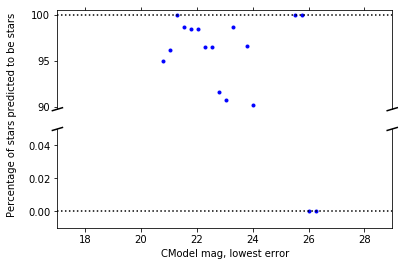

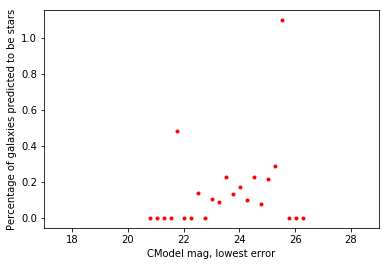

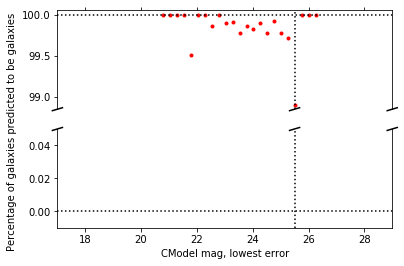

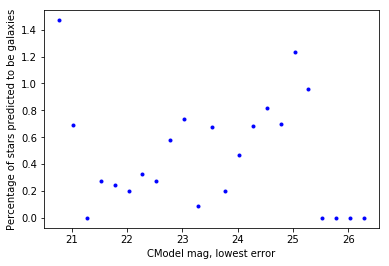

In [10]:
import matplotlib.pyplot as plt
from starGalaxyPlots import broken_axis_plot

xs = t_test["MAG"]
ys = []

sep_prob = 0.5

xs = np.arange(np.min(t_test["MAG"])+4.0, np.max(t_test["MAG"]), 0.25)
for (i, mag) in enumerate(xs[1:]):
    ids = np.where((t_test["CLASS"] == 0) & (probs[:,0] > sep_prob) & \
                   (t_test["MAG"] < mag) & (t_test["MAG"] > xs[i]))[0]
    num = np.where((t_test["MAG"] < mag) & (t_test["CLASS"] == 0) & \
                   (t_test["MAG"] > xs[i]))[0]
    try:
        ys.append(len(ids)/len(num)*100)
    except ZeroDivisionError:
        ys.append(0)

ys = np.array(ys)
xlabel = "CModel mag, lowest error"
ylabel = "Percentage of stars predicted to be stars"
broken_axis_plot(xs[1:], ys, 90, xlabel, ylabel, hline=[0, 100])

ys = []
xs = np.arange(np.min(t_test["MAG"])+4.0, np.max(t_test["MAG"]), 0.25)
for (i, mag) in enumerate(xs[1:]):
    ids = np.where((t_test["CLASS"] == 1) & (probs[:,0] > sep_prob) & \
                   (t_test["MAG"] < mag) & (t_test["MAG"] > xs[i]))[0]
    num = np.where((t_test["MAG"] < mag) & (t_test["CLASS"] == 1) & \
                   (t_test["MAG"] > xs[i]))[0]
    try:
        ys.append(len(ids)/len(num)*100)
    except ZeroDivisionError:
        ys.append(0)
    
plt.plot(xs[1:], ys, "r.")
plt.ylabel("Percentage of galaxies predicted to be stars")
plt.xlabel("CModel mag, lowest error")
plt.xlim(17, 29)
plt.show()

ys = []
xs = np.arange(np.min(t_test["MAG"])+4.0, np.max(t_test["MAG"]), 0.25)
for (i, mag) in enumerate(xs[1:]):
    ids = np.where((t_test["CLASS"] == 1) & (probs[:,0] < sep_prob) & \
                   (t_test["MAG"] < mag) & (t_test["MAG"] > xs[i]))[0]
    num = np.where((t_test["MAG"] < mag) & (t_test["CLASS"] == 1) & \
                   (t_test["MAG"] > xs[i]))[0]
    try:
        ys.append(len(ids)/len(num)*100)
    except ZeroDivisionError:
        ys.append(0)

ys = np.array(ys)
xlabel = "CModel mag, lowest error"
ylabel = "Percentage of galaxies predicted to be galaxies"
broken_axis_plot(xs[1:], ys, 90, xlabel, ylabel, hline=[0, 100], vline=[25.5], col="r")
        
ys = []
xs = np.arange(np.min(t_test["MAG"])+4.0, np.max(t_test["MAG"]), 0.25)
for (i, mag) in enumerate(xs[1:]):
    ids = np.where((t_test["CLASS"] == 0) & (probs[:,0] < sep_prob) & \
                   (t_test["MAG"] < mag) & (t_test["MAG"] > xs[i]))[0]
    num = np.where((t_test["MAG"] < mag) & (t_test["CLASS"] == 1) & \
                   (t_test["MAG"] > xs[i]))[0]
    try:
        ys.append(len(ids)/len(num)*100)
    except ZeroDivisionError:
        ys.append(0)

plt.plot(xs[1:], ys, "b.")
plt.ylabel("Percentage of stars predicted to be galaxies")
plt.xlabel("CModel mag, lowest error")
plt.show()

HST stars classified incorrectly: 140 out of 1610 ~ 8.7%
HST galaxies classified incorrectly: 35 out of 22447 ~ 0.2%
HST stars classified incorrectly: 173 out of 1610 ~ 10.7%
HST galaxies classified incorrectly: 153 out of 22447 ~ 0.7%


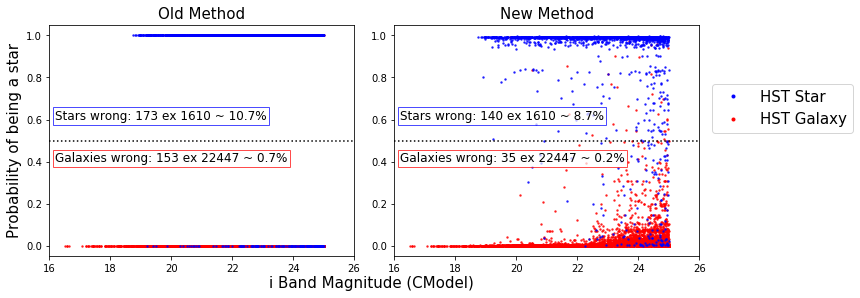

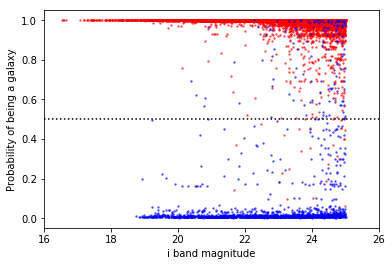

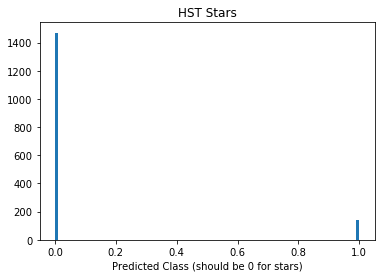

140


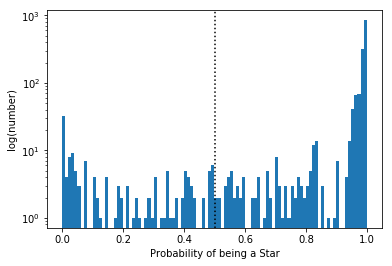

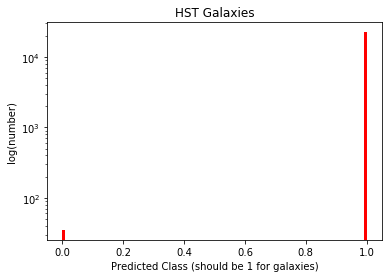

35


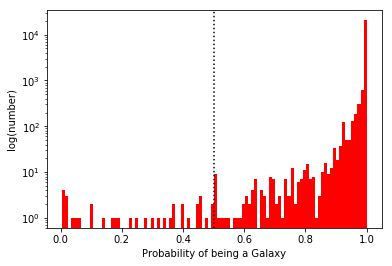

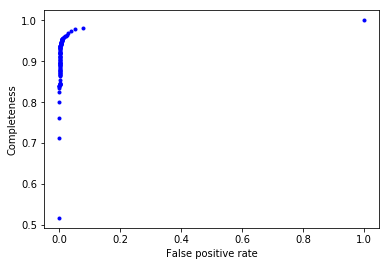

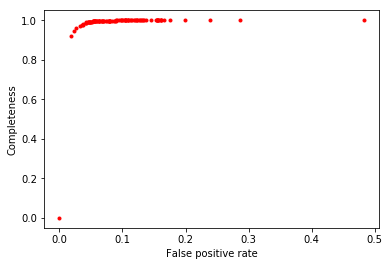

In [11]:
star = np.where((t_test["CLASS"] == 0))[0]
gal = np.where((t_test["CLASS"] == 1))[0]

predictions = np.zeros(len(t_test))
predictions[probs[:,0] < sep_prob] = 1.0

old_star = np.where((t_test["I_PM"] < 0.02))[0]
old_gal = np.where((t_test["I_PM"] > 0.02))[0]

t_test["OLD_CLASS"] = [0.0]*len(t_test)
t_test["OLD_CLASS"][old_star] = 1.0

wrong_stars = np.where((probs[:,0] < sep_prob) & (t_test["CLASS"] == 0))[0]
print("HST stars classified incorrectly:", len(wrong_stars), "out of", len(star), \
      "~ {0:.1f}%".format(len(wrong_stars)/len(star)*100))

wrong_gals = np.where((probs[:,0] > (sep_prob)) & (t_test["CLASS"] == 1))[0]
print("HST galaxies classified incorrectly:", len(wrong_gals), "out of", len(gal), \
     "~ {0:.1f}%".format(len(wrong_gals)/len(gal)*100))

bbox_g={'facecolor':'white', 'alpha':0.7, 'pad':2, 'edgecolor':'red'}
bbox={'facecolor':'white', 'alpha':0.7, 'pad':2, 'edgecolor':'blue'}

info = "Stars wrong: %0.0f ex %0.0f ~ %0.1f" % (len(wrong_stars), len(star), \
                                               len(wrong_stars)/len(star)*100)
info_g = "Galaxies wrong: %0.0f ex %0.0f ~ %0.1f" % (len(wrong_gals), len(gal), \
                                               len(wrong_gals)/len(gal)*100)

wrong_stars_old = np.where((t_test["CLASS"] == 0) & (t_test["OLD_CLASS"] == 0))[0]
print("HST stars classified incorrectly:", len(wrong_stars_old), "out of", len(star), \
      "~ {0:.1f}%".format(len(wrong_stars_old)/len(star)*100))

wrong_gals_old = np.where((t_test["CLASS"] == 1) & (t_test["OLD_CLASS"] == 1))[0]
print("HST galaxies classified incorrectly:", len(wrong_gals_old), "out of", len(gal), \
     "~ {0:.1f}%".format(len(wrong_gals_old)/len(gal)*100))

bbox_g={'facecolor':'white', 'alpha':0.7, 'pad':2, 'edgecolor':'red'}
bbox={'facecolor':'white', 'alpha':0.7, 'pad':2, 'edgecolor':'blue'}

info_old = "Stars wrong: %0.0f ex %0.0f ~ %0.1f" % (len(wrong_stars_old), len(star), \
                                               len(wrong_stars_old)/len(star)*100)
info_g_old = "Galaxies wrong: %0.0f ex %0.0f ~ %0.1f" % (len(wrong_gals_old), len(gal), \
                                               len(wrong_gals_old)/len(gal)*100)

fig, ax_arr = plt.subplots(ncols=2, figsize=(10,4))
ax = ax_arr[0]
ax1 = ax_arr[1]

ax1.text(16.2, 0.6, info + "%", bbox=bbox, fontsize=12)
ax1.text(16.2, 0.4, info_g + "%", bbox=bbox_g, fontsize=12)
ax1.plot(t_test["I"][gal], probs[:,0][gal], "r.", ms=3, alpha=0.7)
ax1.plot(t_test["I"][star], probs[:,0][star], "b.", ms=3, alpha=0.7)
ax1.set_xlim(16.0, 26.0)
ax1.set_ylim(-0.05, 1.05)
ax1.axhline(sep_prob, color="k", ls=":")
#ax1.set_xlabel("i Band Magnitude", fontsize=15)
ax1.set_title("New Method", fontsize=15)

ax.text(16.2, 0.6, info_old + "%", bbox=bbox, fontsize=12)
ax.text(16.2, 0.4, info_g_old + "%", bbox=bbox_g, fontsize=12)
ax.plot(t_test["I"][gal], t_test["OLD_CLASS"].data[gal], "r.", ms=3, alpha=0.7)
ax.plot(t_test["I"][star], t_test["OLD_CLASS"].data[star], "b.", ms=3, alpha=0.7)
ax.set_xlim(16.0, 26.0)
ax.set_ylim(-0.05, 1.05)
ax.axhline(sep_prob, color="k", ls=":")
#ax.set_xlabel("i band magnitude", fontsize=15)
ax.set_ylabel("Probability of being a star", fontsize=15)
ax.set_title("Old Method", fontsize=15)
ax.text(23.2, -0.2, "i Band Magnitude (CModel)", fontsize=15)

ax.plot([-1], [-1], "b.", label = "HST Star")
ax.plot([-1], [-1], "r.", label = "HST Galaxy")

leg = ax.legend(loc='lower left', bbox_to_anchor=(2.15, 0.5), ncol=1, fontsize=15)
plt.tight_layout()
plt.show()

plt.plot(t_test["I"][gal], probs[:,1][gal], "r.", ms=3, alpha=0.5)
plt.plot(t_test["I"][star], probs[:,1][star], "b.", ms=3, alpha=0.5)
plt.xlim(16.0, 26.0)
plt.xlabel("i band magnitude")
plt.axhline(1-sep_prob, color="k", ls=":")
plt.ylabel("Probability of being a galaxy")
plt.show()

plt.hist(predictions[star], bins=100)
plt.title("HST Stars")
plt.xlabel("Predicted Class (should be 0 for stars)")
plt.show()

print(len(np.where((predictions[star] == 1))[0]))

plt.hist(probs[:,0][star], bins=100)
plt.axvline(sep_prob, color="k", ls=":")
plt.xlabel("Probability of being a Star")
plt.yscale("log")
plt.ylabel("log(number)")
plt.show()

plt.hist(predictions[gal], bins=100, color="r")
plt.title("HST Galaxies")
plt.xlabel("Predicted Class (should be 1 for galaxies)")
plt.yscale("log")
plt.ylabel("log(number)")
plt.show()

print(len(np.where((predictions[gal] == 0))[0]))

plt.hist(probs[:,1][gal], bins=100, color="r")
plt.xlabel("Probability of being a Galaxy")
plt.yscale("log")
plt.ylabel("log(number)")
plt.axvline(1-sep_prob, color="k", ls=":")
plt.show()

xs = []
ys = []
for thresh in np.arange(0.0, 1.0, 0.01):
    false_positive = np.where((t_test["CLASS"] == 1) & (probs[:,0] > thresh))[0]
    true_positive = np.where((t_test["CLASS"] == 0) & (probs[:,0] > thresh))[0]
    false_negatives = np.where((t_test["CLASS"] == 0) & (probs[:,1] > (1-thresh)))[0]
    true_negative = np.where((t_test["CLASS"] == 1) & (probs[:,1] > (1-thresh)))[0]
    
    try:
        xs.append(len(false_positive)/(len(false_positive) + len(true_negative)))
    except ZeroDivisionError:
        xs.append(0.0)
    try:
        ys.append(len(true_positive)/(len(false_negatives) + len(true_positive)))
    except ZeroDivisionError:
        ys.append(0.0)

plt.plot(xs, ys, "b.")
plt.xlabel("False positive rate")
plt.ylabel("Completeness")
plt.show()

xs = []
ys = []
for thresh in np.arange(0.0, 1.0, 0.01):
    false_positive = np.where((t_test["CLASS"] == 0) & (probs[:,0] < thresh))[0]
    true_positive = np.where((t_test["CLASS"] == 1) & (probs[:,0] < thresh))[0]
    false_negatives = np.where((t_test["CLASS"] == 1) & (probs[:,0] > (thresh)))[0]
    true_negative = np.where((t_test["CLASS"] == 0) & (probs[:,0] > (thresh)))[0]
    
    try:
        xs.append(len(false_positive)/(len(false_positive) + len(true_negative)))
    except ZeroDivisionError:
        xs.append(0.0)
    try:
        ys.append(len(true_positive)/(len(false_negatives) + len(true_positive)))
    except ZeroDivisionError:
        ys.append(0.0)

plt.plot(xs, ys, "r.")
plt.xlabel("False positive rate")
plt.ylabel("Completeness")
plt.show()

HST stars classified incorrectly: 140 out of 1610 ~ 8.7%
HST galaxies classified incorrectly: 35 out of 22447 ~ 0.2%


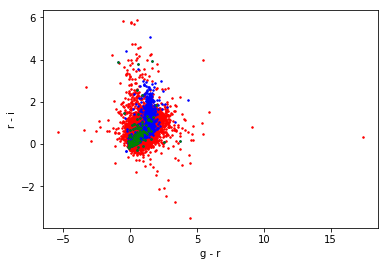

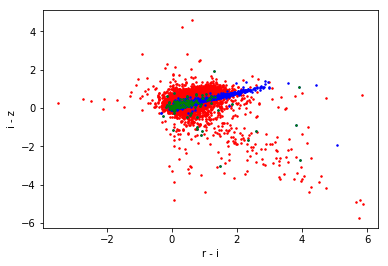

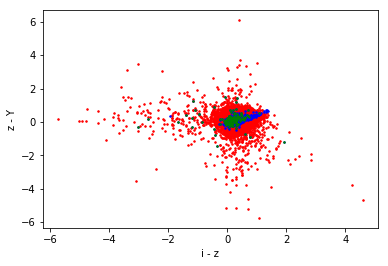

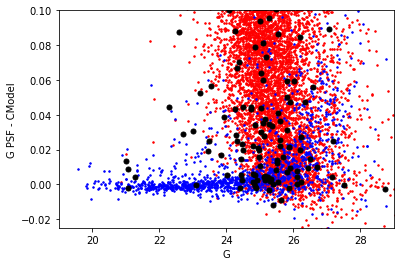

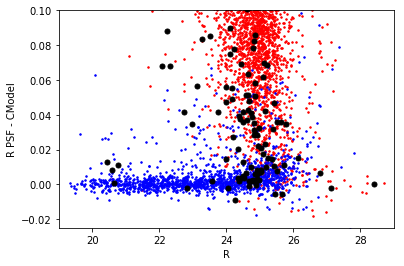

...

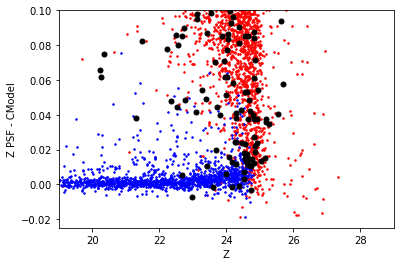

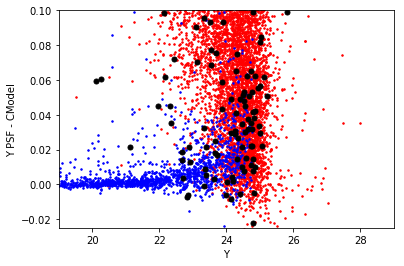

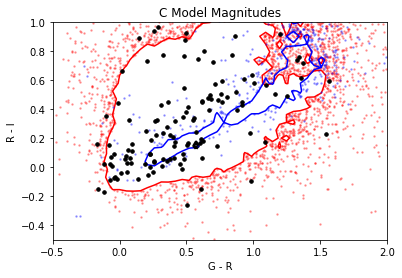

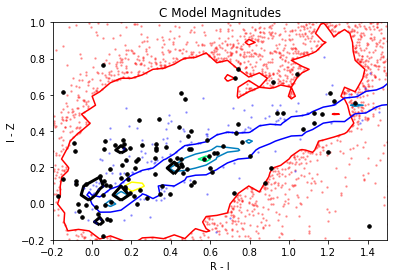

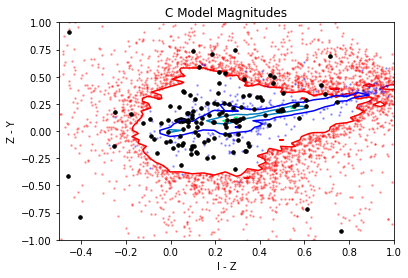

In [12]:
wrong_stars = np.where((probs[:,0] < sep_prob) & (t_test["CLASS"] == 0))[0]
print("HST stars classified incorrectly:", len(wrong_stars), "out of", len(star), \
      "~ {0:.1f}%".format(len(wrong_stars)/len(star)*100))

wrong_gals = np.where((probs[:,0] > (sep_prob)) & (t_test["CLASS"] == 1))[0]
print("HST galaxies classified incorrectly:", len(wrong_gals), "out of", len(gal), \
     "~ {0:.1f}%".format(len(wrong_gals)/len(gal)*100))


#for col in t_test.columns[2:]:
#    plt.hist(t_test[col][gal], bins = 1000, color="r")
#    plt.hist(t_test[col][star], bins = 1000, color="b")
#    plt.hist(t_test[col][wrong_stars], bins = 1000, color="g")
#    plt.xlabel(col)
#    plt.show()

plt.plot(t_test["GR"][gal], t_test["RI"][gal], "r.", ms=3)
plt.plot(t_test["GR"][star], t_test["RI"][star], "b.", ms=3)
plt.plot(t_test["GR"][wrong_stars], t_test["RI"][wrong_stars], "g.", ms=3)
plt.xlabel("g - r")
plt.ylabel("r - i")
plt.show()

plt.plot(t_test["RI"][gal], t_test["IZ"][gal], "r.", ms=3)
plt.plot(t_test["RI"][star], t_test["IZ"][star], "b.", ms=3)
plt.plot(t_test["RI"][wrong_stars], t_test["IZ"][wrong_stars], "g.", ms=3)
plt.xlabel("r - i")
plt.ylabel("i - z")
plt.show()

plt.plot(t_test["IZ"][gal], t_test["ZY"][gal], "r.", ms=3)
plt.plot(t_test["IZ"][star], t_test["ZY"][star], "b.", ms=3)
plt.plot(t_test["IZ"][wrong_stars], t_test["ZY"][wrong_stars], "g.", ms=3)
plt.xlabel("i - z")
plt.ylabel("z - Y")
plt.show()

for band in ["G", "R", "I", "Z", "Y"]:
    plt.plot(t_test[band][gal], t_test[band + "_PM"][gal], "r.", ms=3)
    plt.plot(t_test[band][star], t_test[band + "_PM"][star], "b.", ms=3)
    plt.plot(t_test[band][wrong_stars], t_test[band + "_PM"][wrong_stars], "k.", ms=10)
    plt.ylim(-0.025, 0.1)
    plt.xlim(19, 29)
    plt.xlabel(band)
    plt.ylabel(band + " PSF - CModel")
    plt.show()

    
magCol = "magPsf_"
magModCol = "magModel_"
magPsfCol = "magPsf_"

xlims = [(-0.5,2), (-0.2,1.5), (-0.5,1.0)]
ylims = [(-0.5,1), (-0.2,1.0), (-1.0,1.0)]

i = 0
bands = ["GR", "RI", "IZ", "ZY"]
while i < len(bands)-1:
    
    xs_s = t_test[bands[i]][star]
    ys_s = t_test[bands[i+1]][star]
    xs_e = t_test[bands[i]][gal]
    ys_e = t_test[bands[i+1]][gal]
    xs_w = t_test[bands[i]][wrong_stars]
    ys_w = t_test[bands[i+1]][wrong_stars]
   
    counts_s, xbins_s, ybins_s, im = plt.hist2d(xs_s, ys_s, bins=100)
    counts_e, xbins_e, ybins_e, im = plt.hist2d(xs_e, ys_e, bins=(xbins_s, ybins_s))
    counts_w, xbins_w, ybins_w, im = plt.hist2d(xs_w, ys_w, bins=(xbins_s, ybins_s))
    plt.close()
    levels = np.arange(np.min(counts_e[counts_e > 0])*10, np.max(counts_e), 200)
    x = xbins_e[:-1]
    y = ybins_e[:-1]
    z = counts_e.T
    levels_e = plt.contour(x, y, z, cmap=plt.cm.autumn, levels=levels)
    paths_e = levels_e.collections[0].get_paths()
    inside = paths_e[0].contains_points(np.array([xs_e, ys_e]).T)
    for path_e in paths_e[1:]:
        inside_new = path_e.contains_points(np.array([xs_e, ys_e]).T)
        inside = inside | inside_new
    plt.plot(xs_e[~inside], ys_e[~inside], "r.", ms=3, alpha=0.3, mfc="r", zorder=-1)
        
    levels = np.arange(np.min(counts_s[counts_s > 0])*5, np.max(counts_s), 20)
    x = xbins_s[:-1]
    y = ybins_s[:-1]
    z = counts_s.T
    levels_s = plt.contour(x, y, z, cmap=plt.cm.winter, levels = levels)
    paths_s = levels_s.collections[0].get_paths()
    inside = paths_s[0].contains_points(np.array([xs_s, ys_s]).T)
    for path_s in paths_s[1:]:
        inside_new = path_s.contains_points(np.array([xs_s, ys_s]).T)
        inside = inside | inside_new
    plt.plot(xs_s[~inside], ys_s[~inside], "b.", ms=3, alpha=0.3)
    
    levels = np.arange(np.min(counts_w[counts_w > 0])*2, np.max(counts_w), 5)
    x = xbins_w[:-1]
    y = ybins_w[:-1]
    z = counts_w.T
    try:
        levels_w = plt.contour(x, y, z, colors="k", levels=levels, linewidths=3)
        paths_w = levels_w.collections[0].get_paths()
        inside = paths_w[0].contains_points(np.array([xs_w, ys_w]).T)
        for path_w in paths_w[1:]:
            inside_new = path_w.contains_points(np.array([xs_w, ys_w]).T)
            inside = inside | inside_new
        plt.plot(xs_w[~inside], ys_w[~inside], "k.", ms=7)
    except ValueError:
        plt.plot(xs_w, ys_w, "k.", ms=7)
    
    
    plt.title("C Model Magnitudes")
    plt.xlim(xlims[i])
    plt.ylim(ylims[i])
    plt.xlabel(bands[i][0] + " - " + bands[i][1])
    plt.ylabel(bands[i+1][0] + " - " + bands[i+1][1])
    plt.show()

    i += 1

140 140


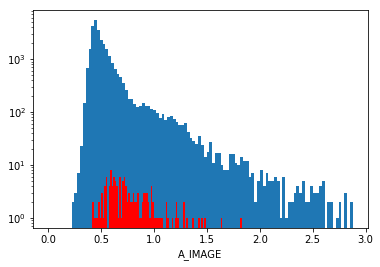

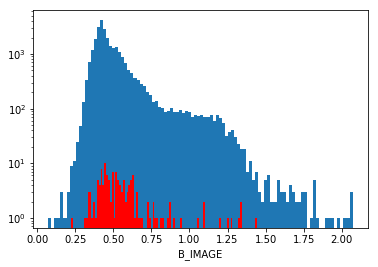

In [13]:
ws_hsc = t_test[wrong_stars]

dists, inds = match_lists.match_lists(ws_hsc["RA"], ws_hsc["DEC"], \
                                      t_hst["ALPHAPEAK_J2000"], t_hst["DELTAPEAK_J2000"], 2.0/3600.0)

match = np.where((inds != len(t_hst)))[0]

ws_hsc = t_hst[match]

print(len(match), len(ws_hsc))

plt.hist(np.log10(t_hst["A_IMAGE"][t_hst["MU_CLASS"] == 2]), bins=100)
plt.hist(np.log10(t_hst["A_IMAGE"][t_hst["MU_CLASS"] == 0]), bins=100)
plt.hist(np.log10(ws_hsc["A_IMAGE"]), bins=100, color="r")
plt.yscale("log")
plt.xlabel("A_IMAGE")
plt.show()

plt.hist(np.log10(t_hst["B_IMAGE"][t_hst["MU_CLASS"] == 2]), bins=100)
plt.hist(np.log10(ws_hsc["B_IMAGE"]), bins=100, color="r")
plt.yscale("log")
plt.xlabel("B_IMAGE")
plt.show()

65
150.34486436 2.19860983997
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits



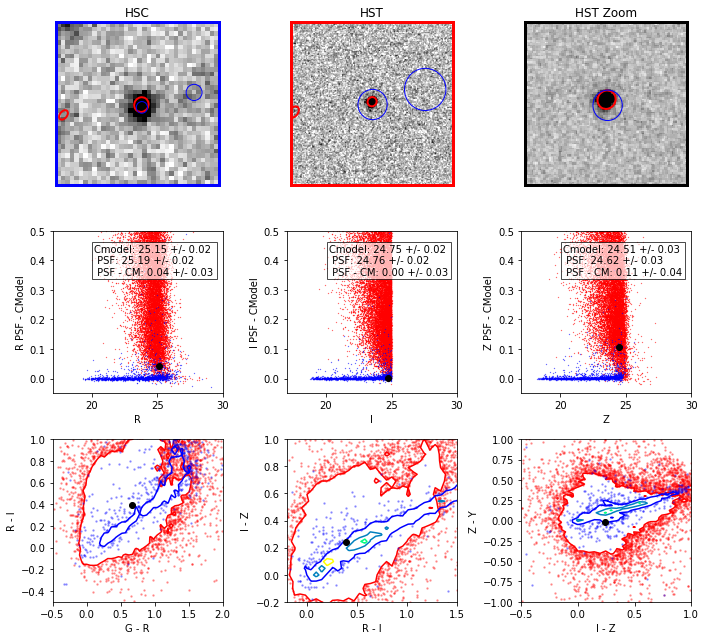

149.939835212 2.42652801669
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_078_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_078_sci.fits



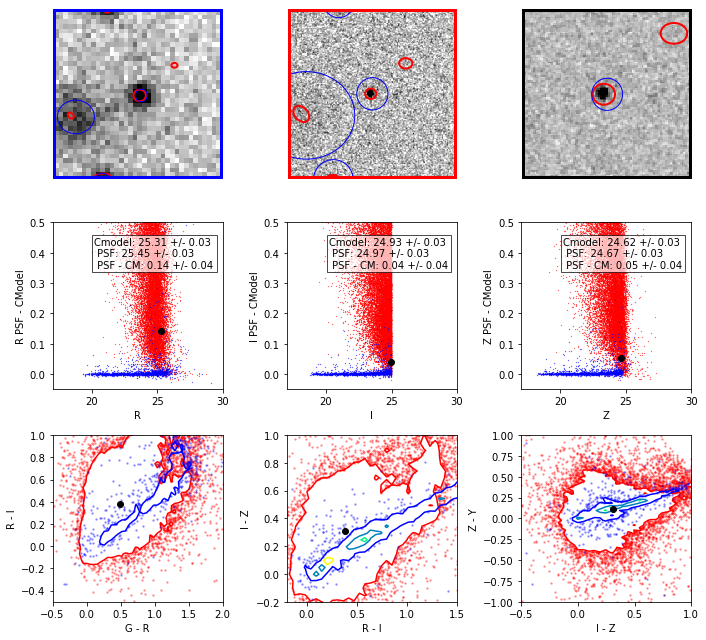

149.494828633 2.31560706305
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_081_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_081_sci.fits



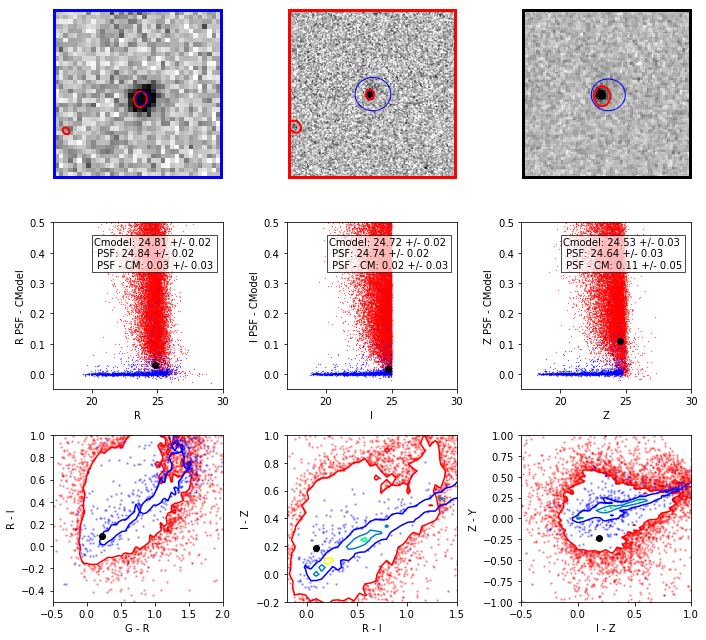

150.114990141 2.68029924267
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_101_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_101_sci.fits



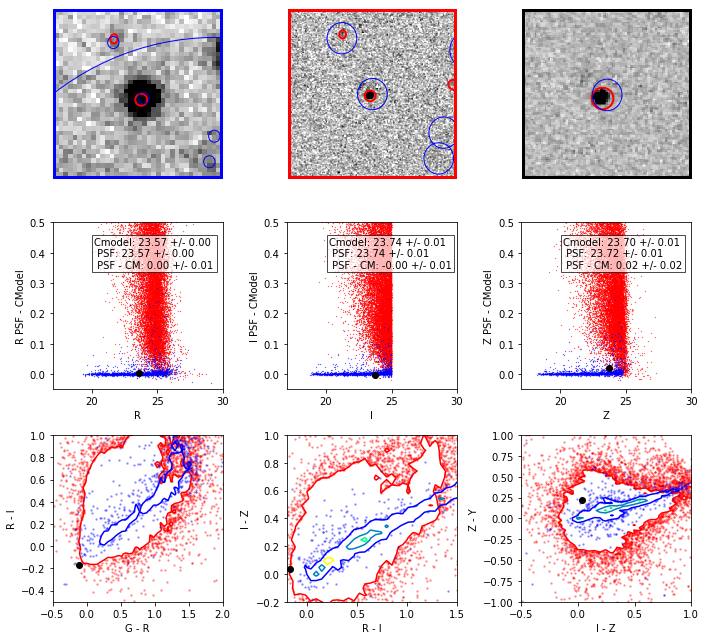

150.28058883 2.44995863809
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits



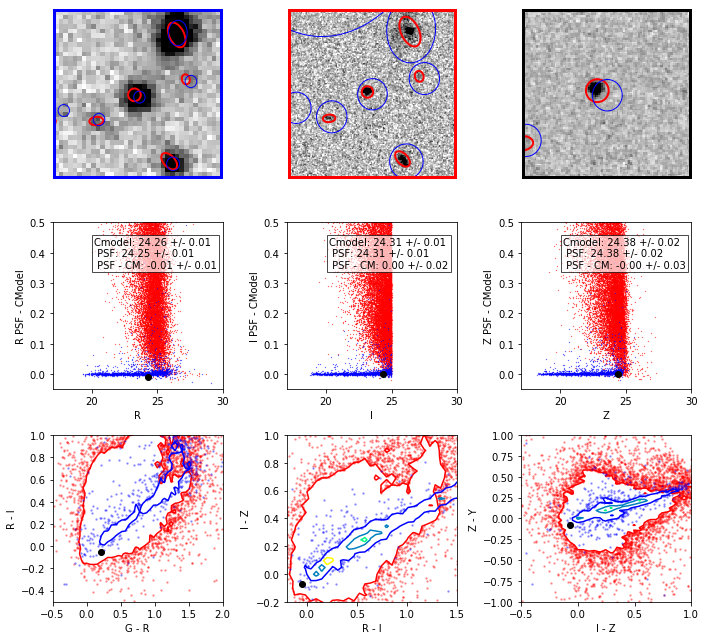

149.676604033 1.92036765403
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_044_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_044_sci.fits



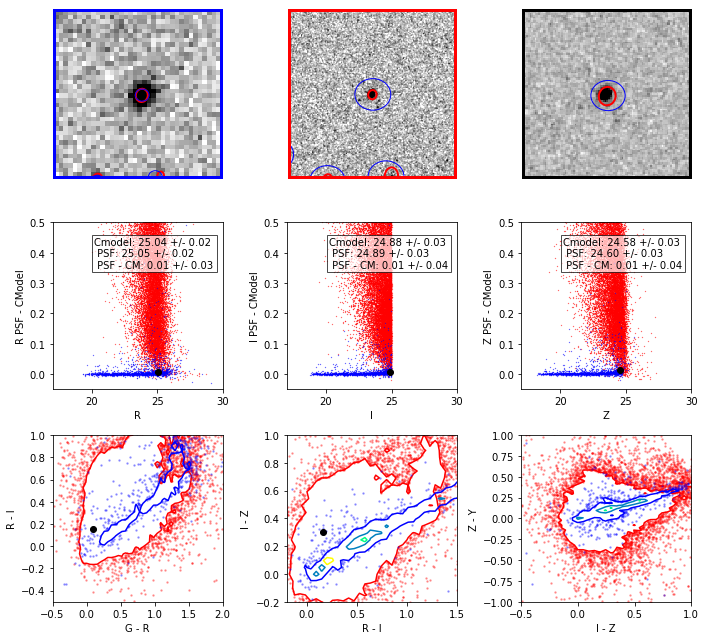

150.34590452 2.14751496872
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits



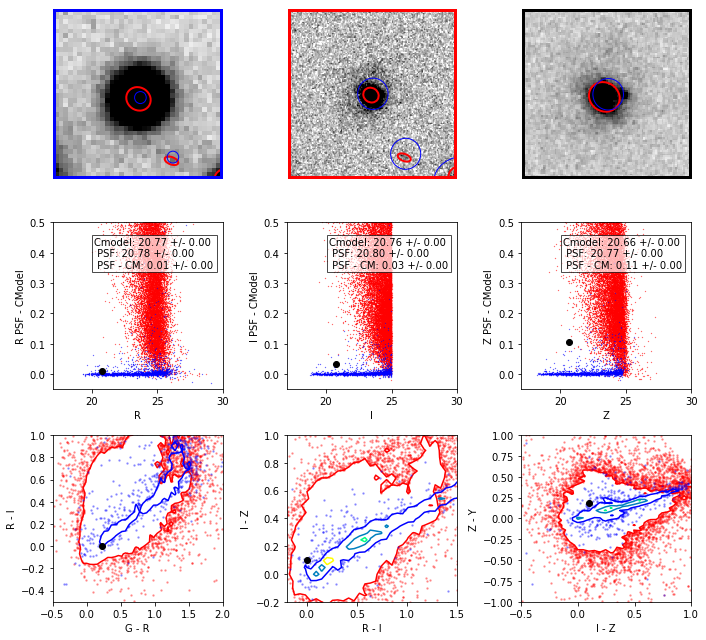

150.443232339 2.60605041912
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_087_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_087_sci.fits



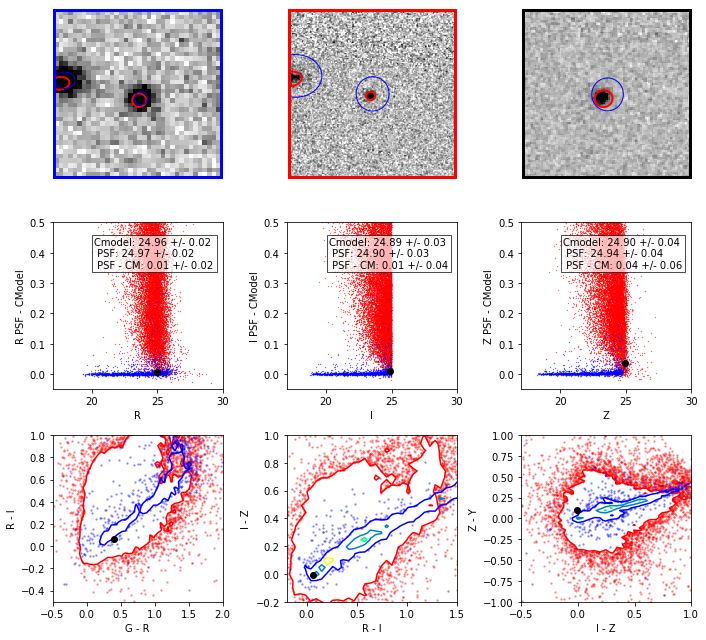

150.700722423 1.89543566574
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_038_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_038_sci.fits



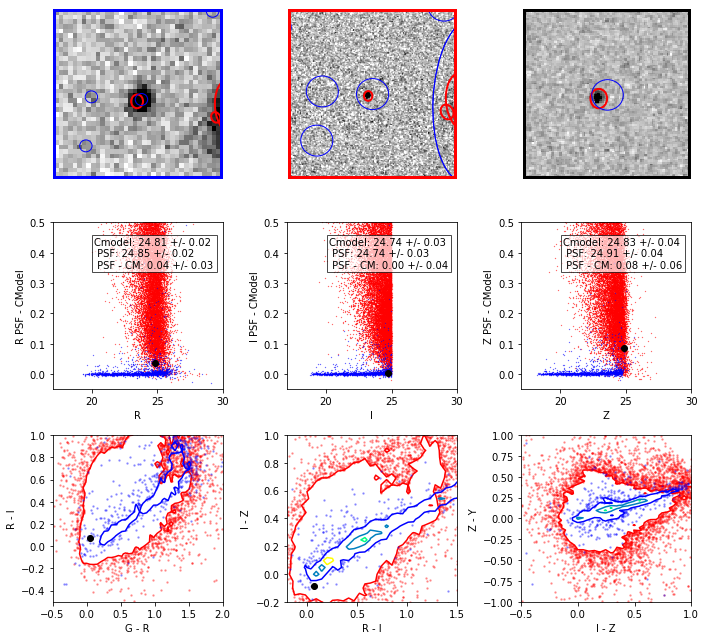

149.920797734 1.89812391789
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_042_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_042_sci.fits



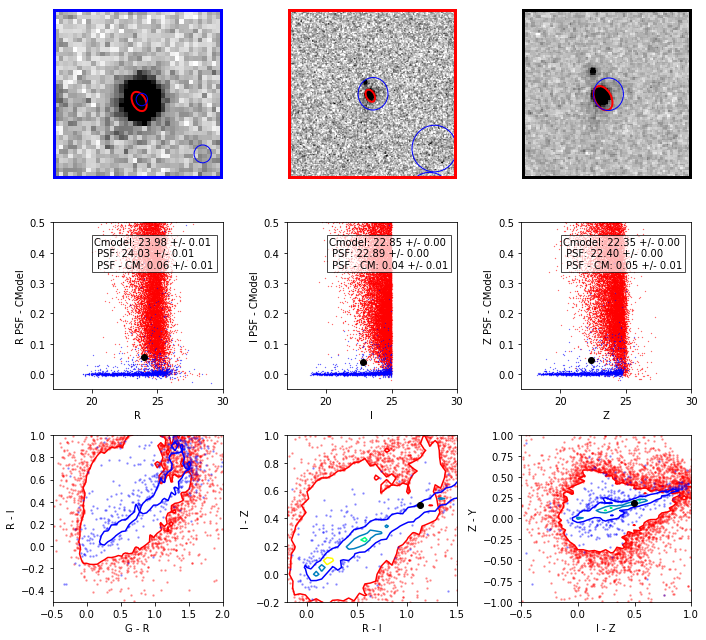

150.182366109 2.82781631994
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_113_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_113_sci.fits



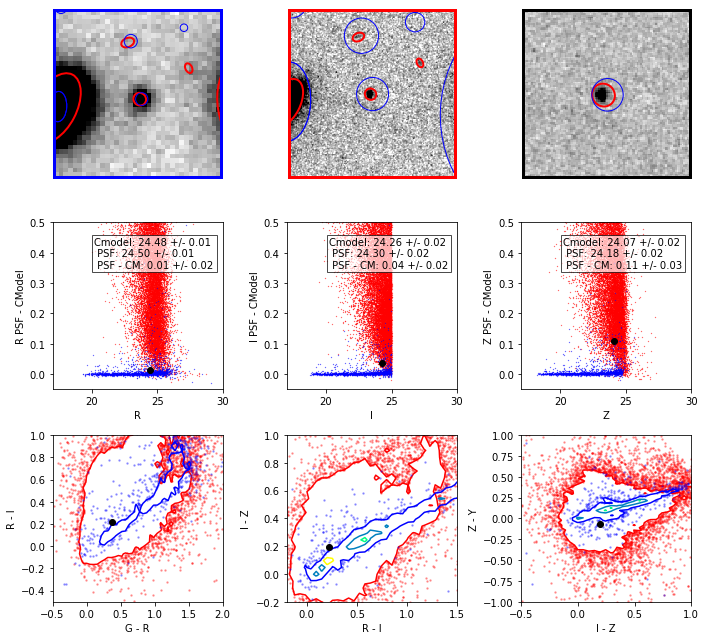

150.577416695 2.68177060294
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_098_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_098_sci.fits



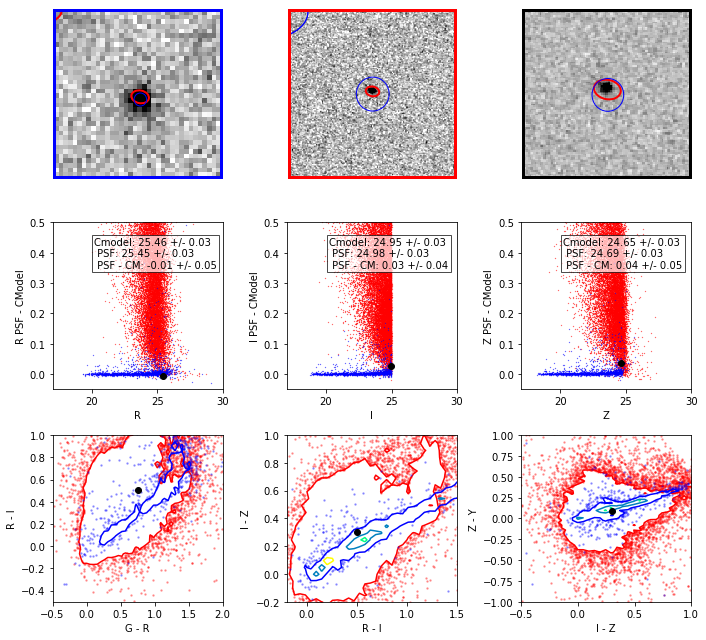

150.080802623 2.53259346492
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_089_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_089_sci.fits



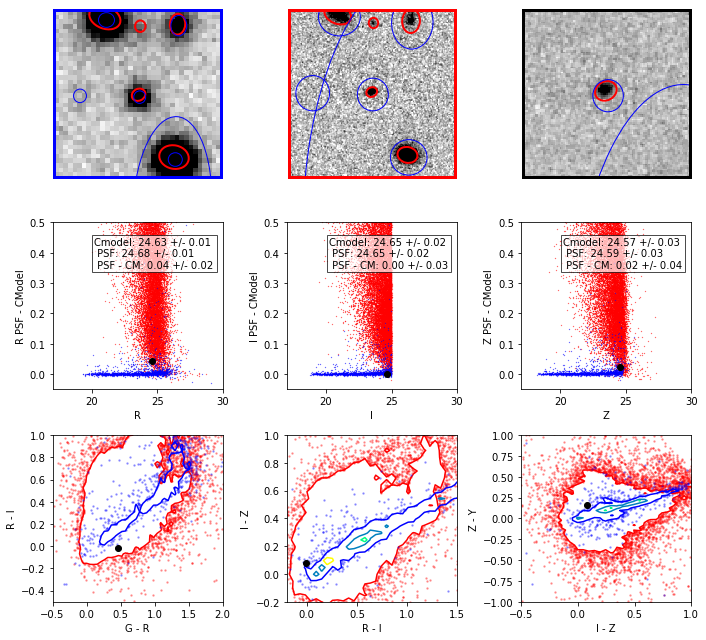

150.611655408 2.13477074475
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_062_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_062_sci.fits



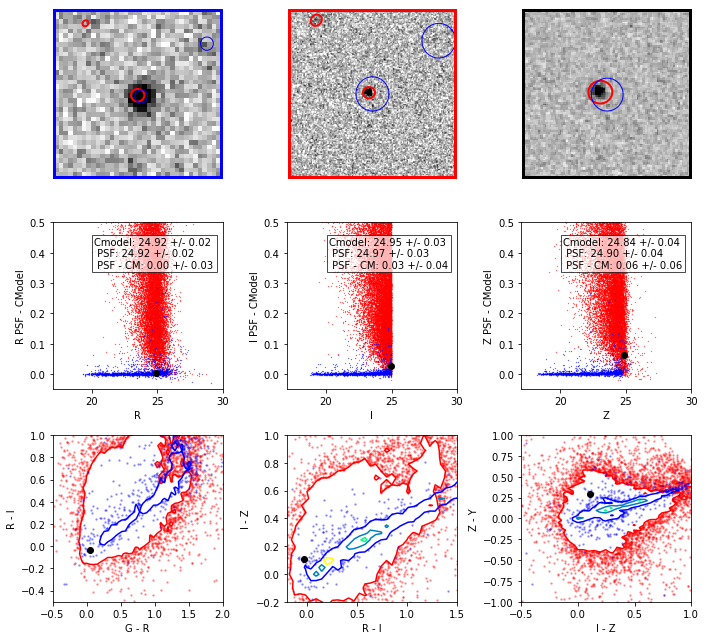

150.622500591 2.7123664501
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_098_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_098_sci.fits



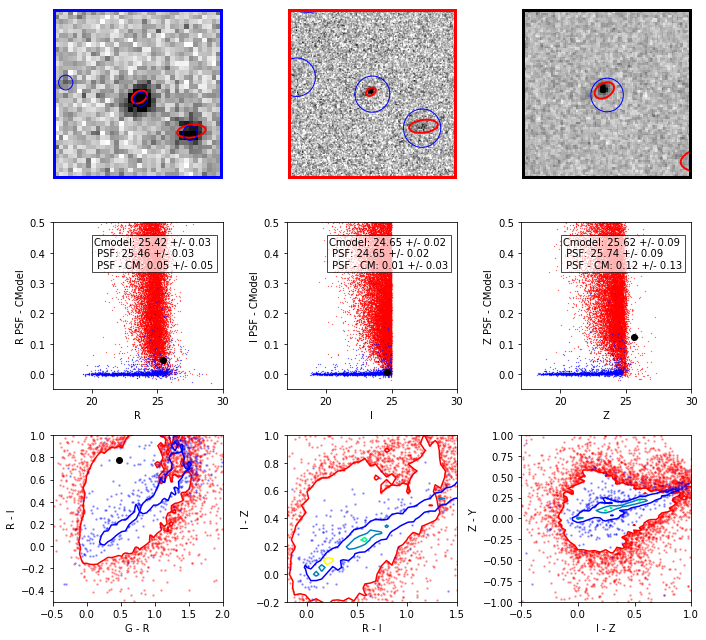

149.772762728 1.95386641927
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_043_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_043_sci.fits



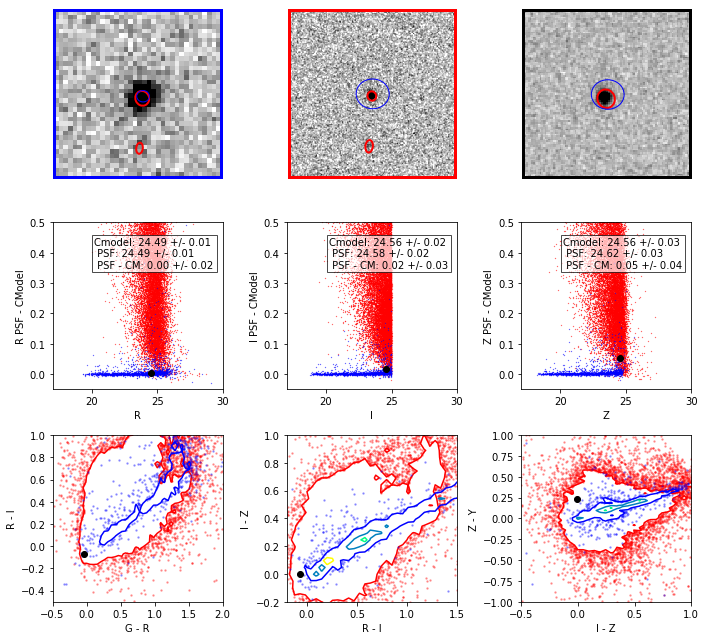

150.621318132 2.3949243755
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_074_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_074_sci.fits



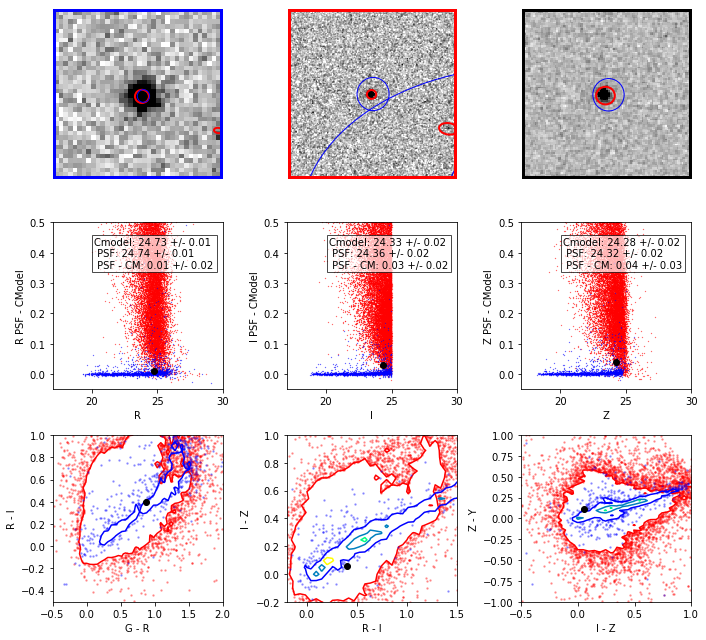

149.952022791 2.37803138469
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_078_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_078_sci.fits



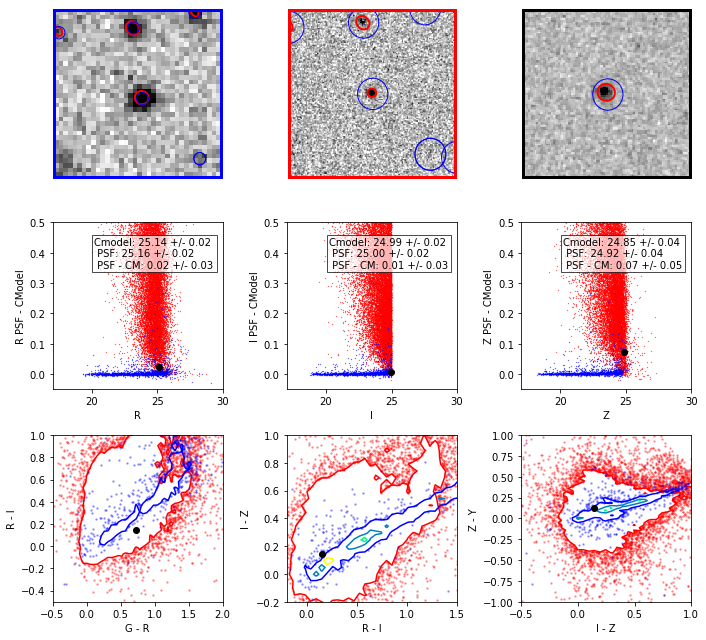

150.331559202 2.27774734502
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits



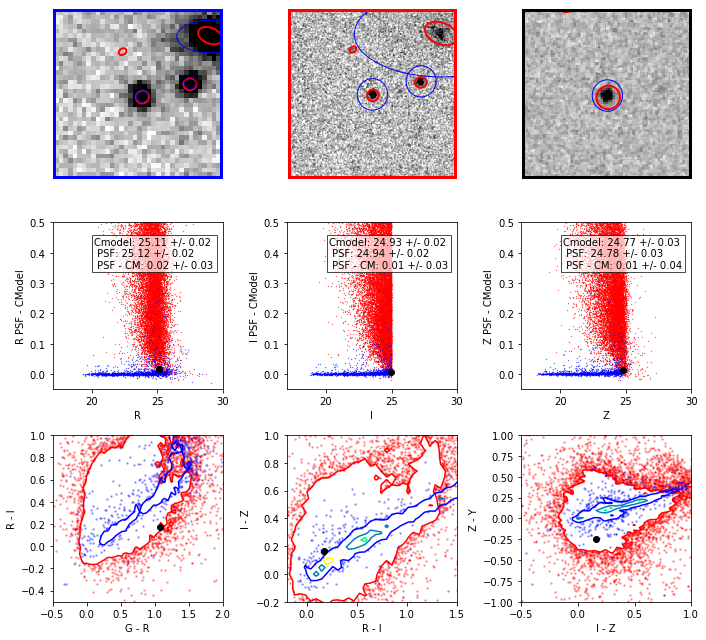

149.658794853 2.07197688333
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_056_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_056_sci.fits



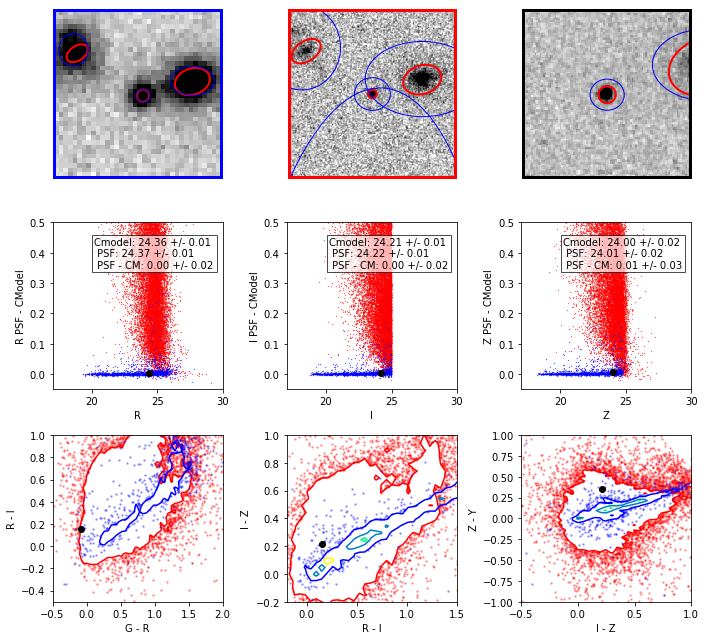

149.855802967 2.6811750412
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_103_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_103_sci.fits



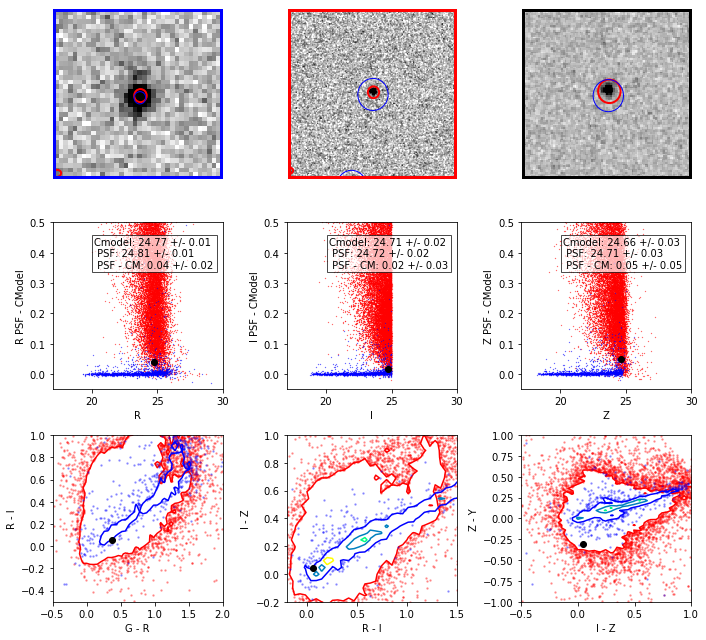

150.247616608 1.65941088716
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits



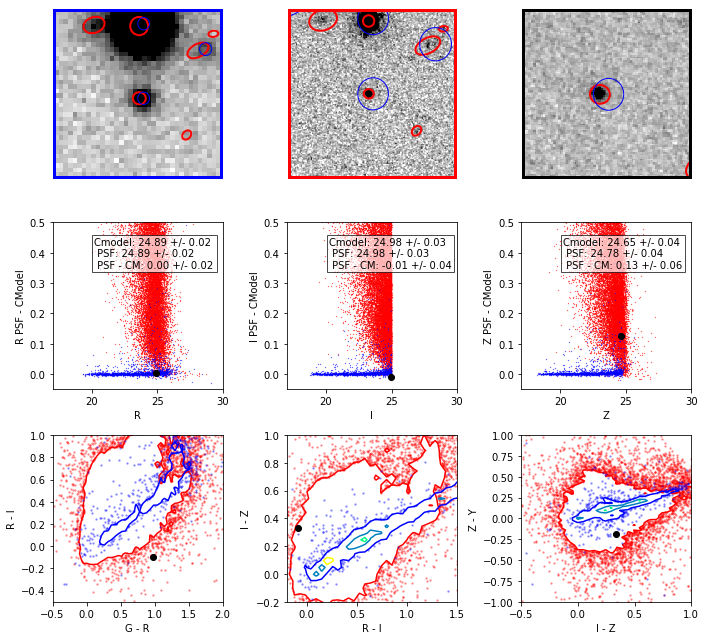

150.183528355 2.1718807697
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_065_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_065_sci.fits



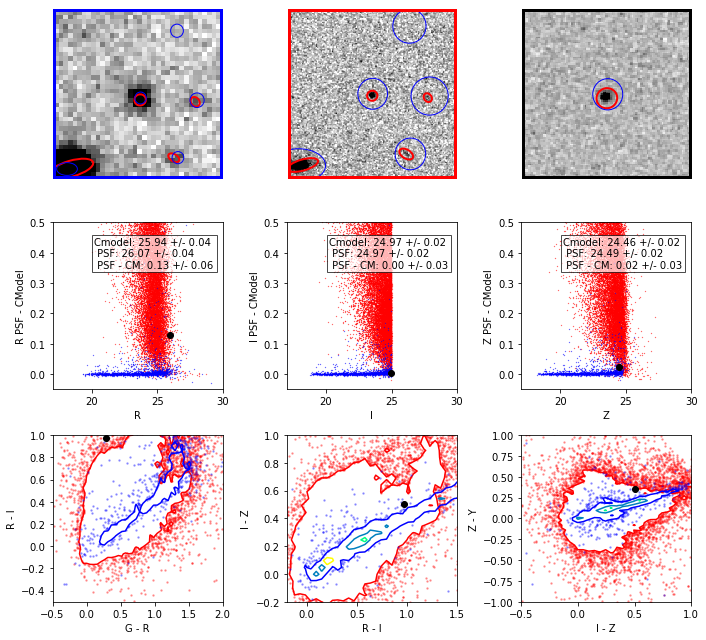

150.139207316 2.07695452153
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_053_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_053_sci.fits



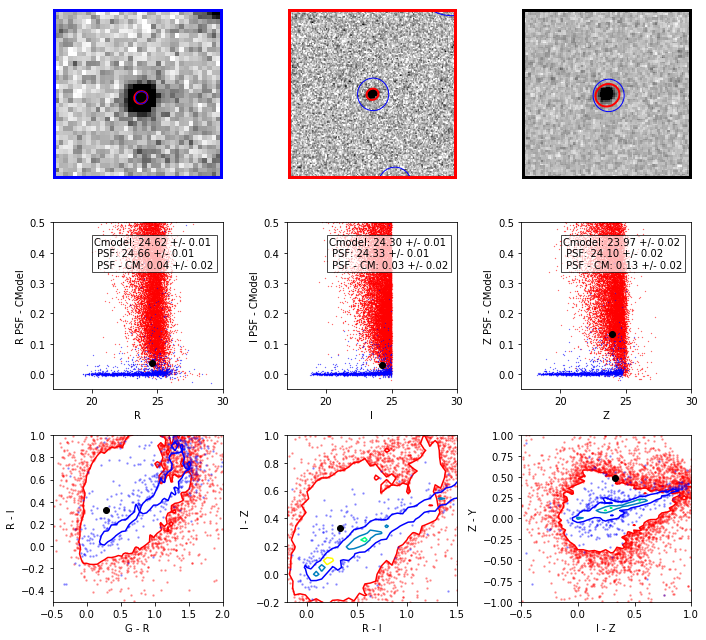

149.690479861 2.61823873091
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_092_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_092_sci.fits



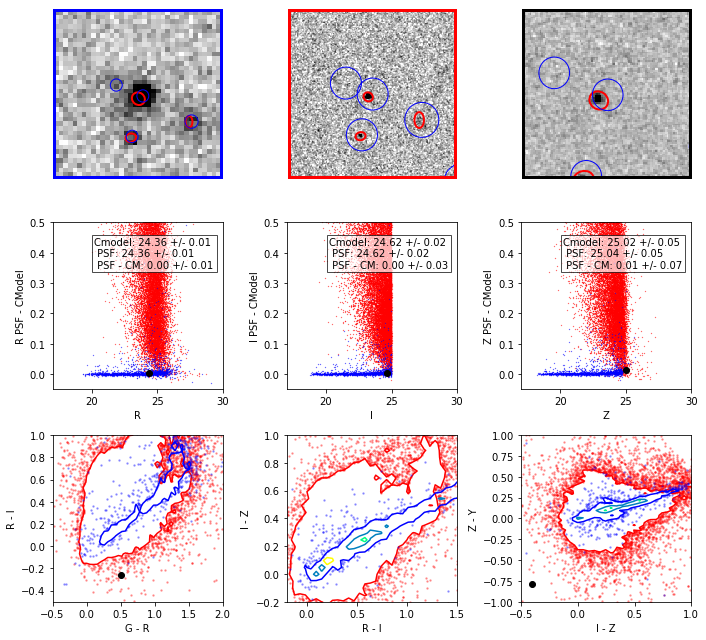

150.716219561 2.6194760649
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_086_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_086_sci.fits



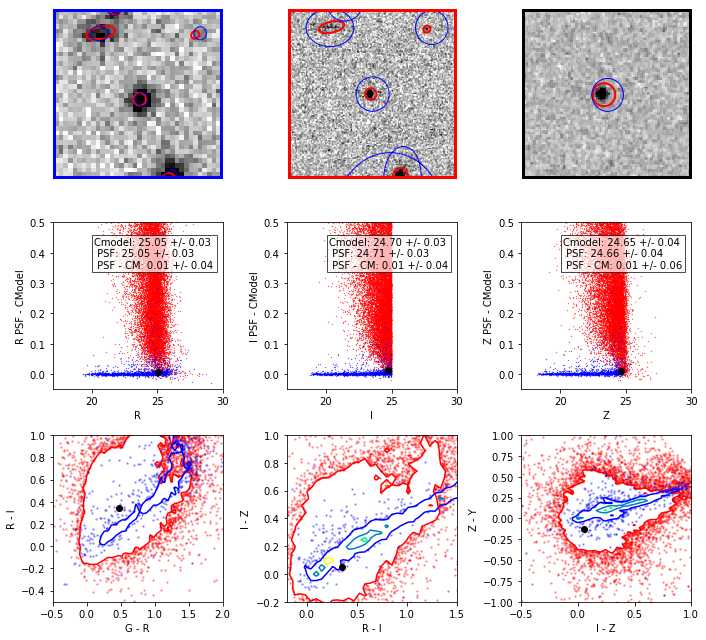

150.529078229 1.78539075793
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_027_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_027_sci.fits



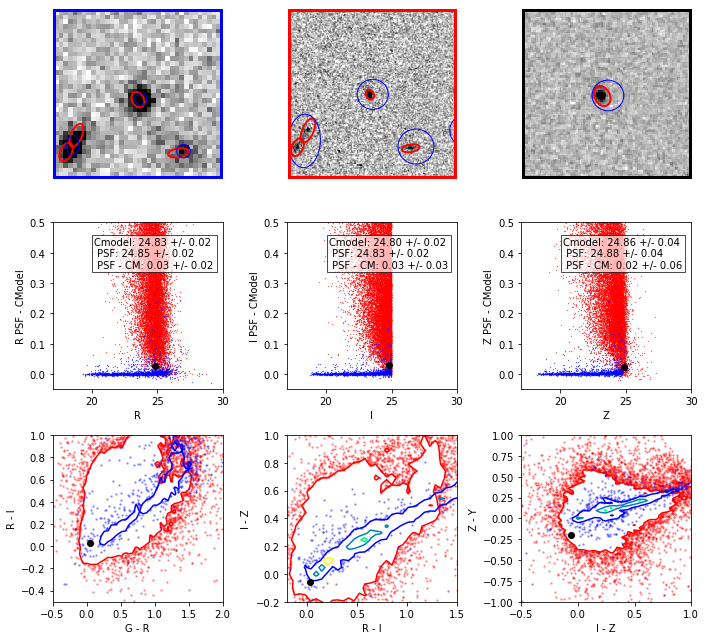

149.750271499 2.64470402314
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_103_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_103_sci.fits



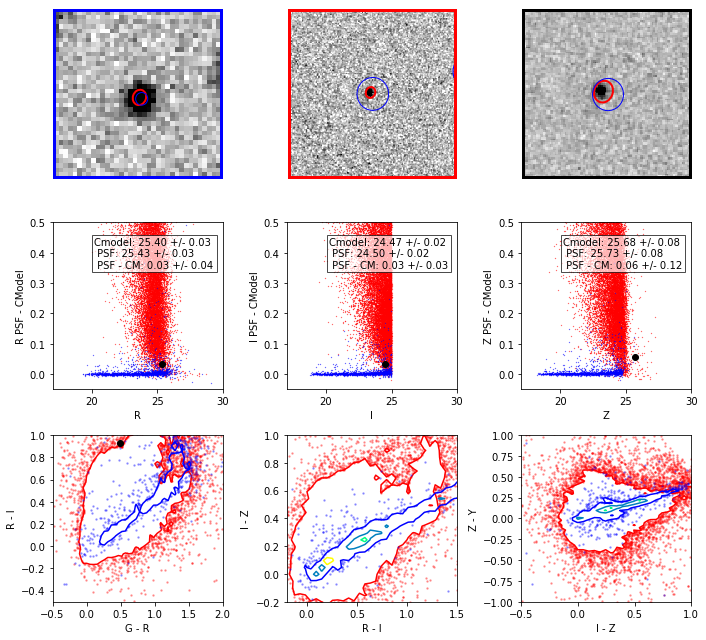

150.308936389 2.16845259015
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_064_sci.fits



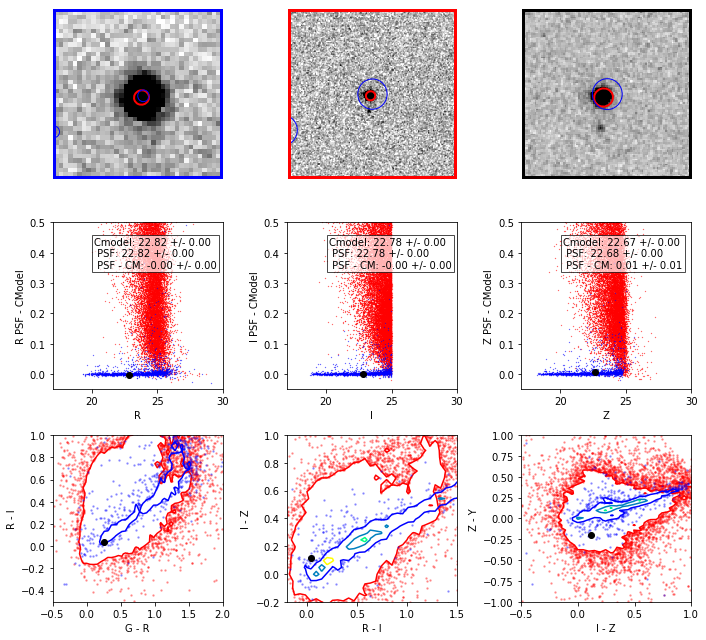

149.516208114 2.13274642597
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_069_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_069_sci.fits



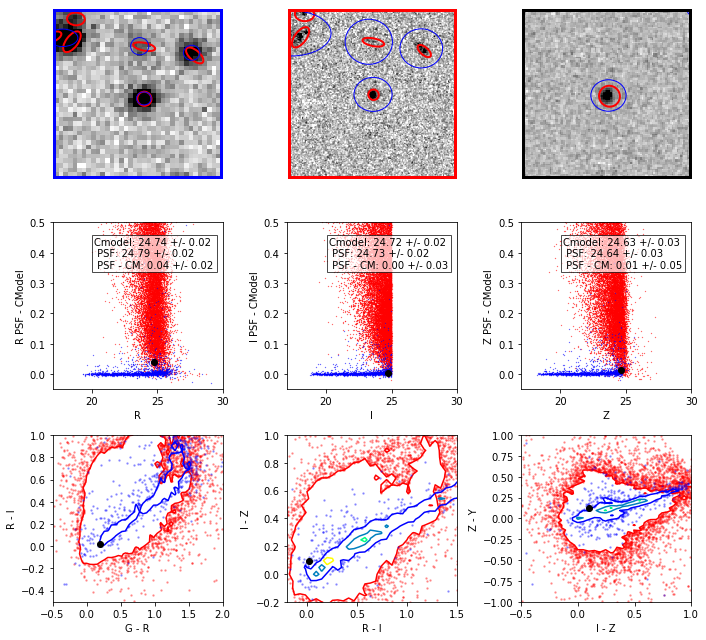

149.46608694 2.64709316876
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_105_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_105_sci.fits



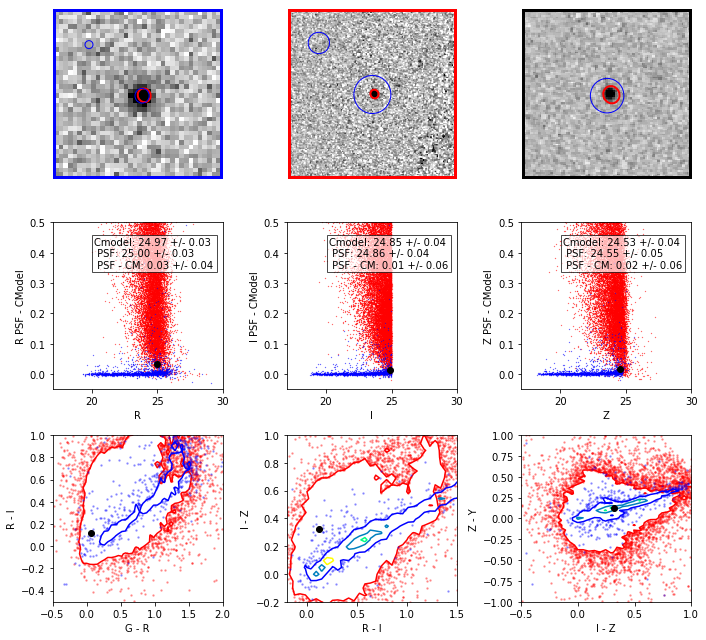

150.281884943 2.04241731519
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_052_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_052_sci.fits



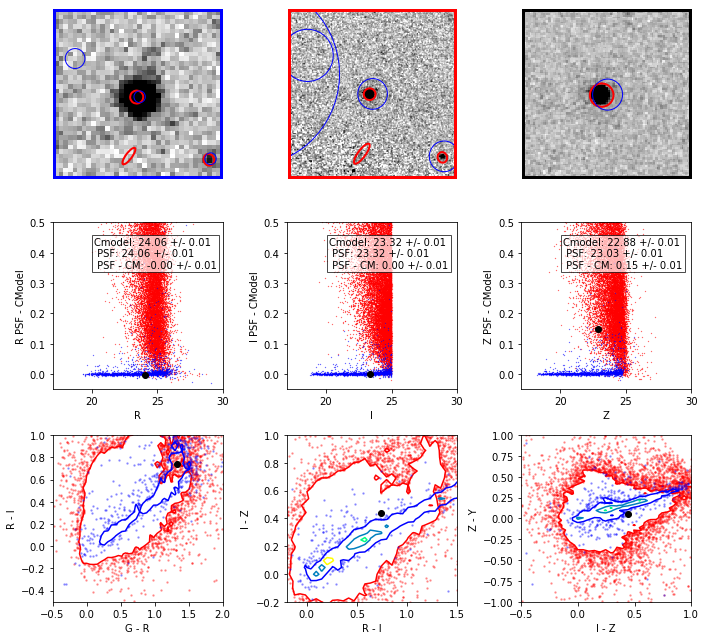

149.976493267 2.73625603824
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_102_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_102_sci.fits



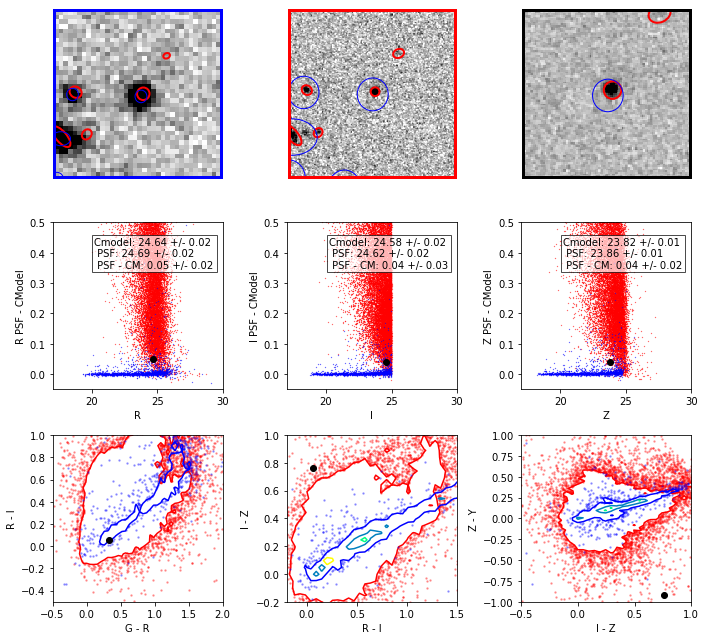

150.585971562 2.27016127911
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_062_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_062_sci.fits



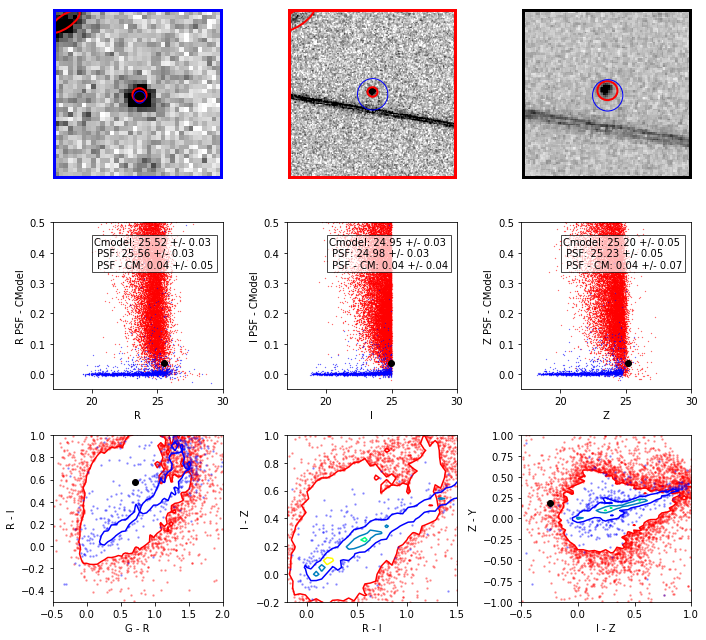

150.010799663 1.98816303384
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_054_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_054_sci.fits



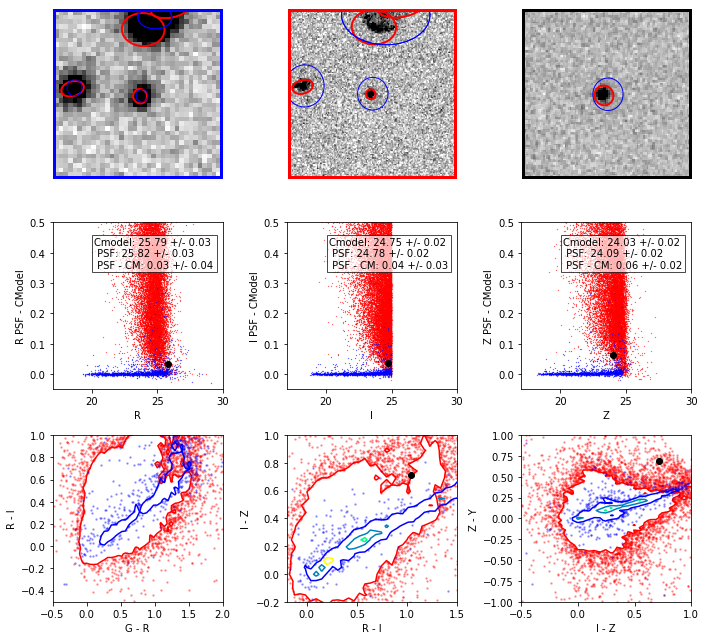

149.859971251 2.46221437148
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_091_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_091_sci.fits



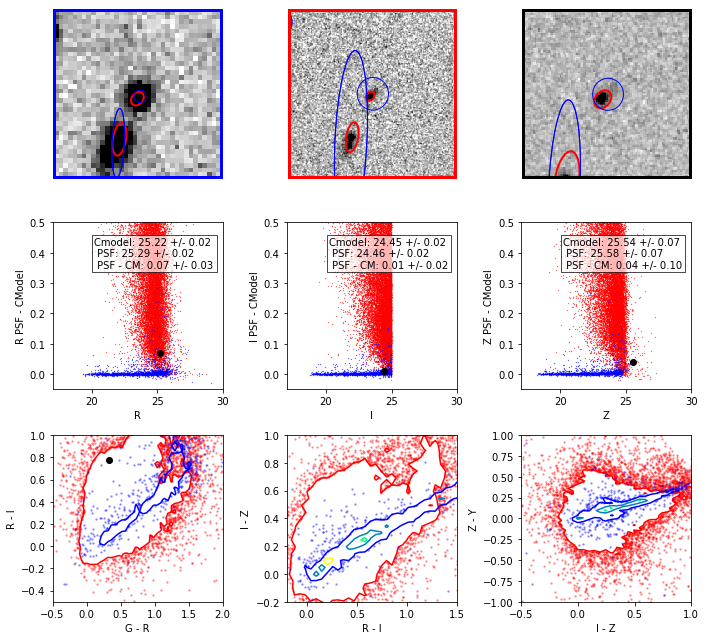

150.38343972 1.94358150553
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits



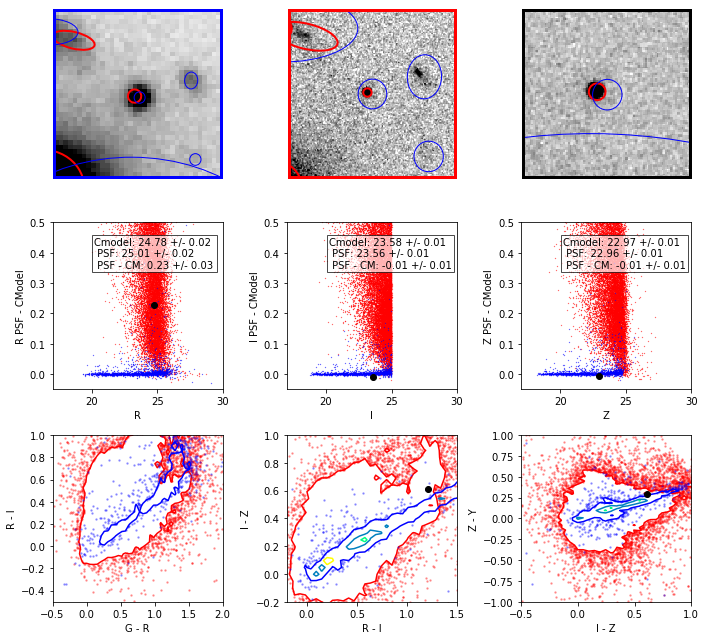

150.661622398 2.59582071276
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_086_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_086_sci.fits



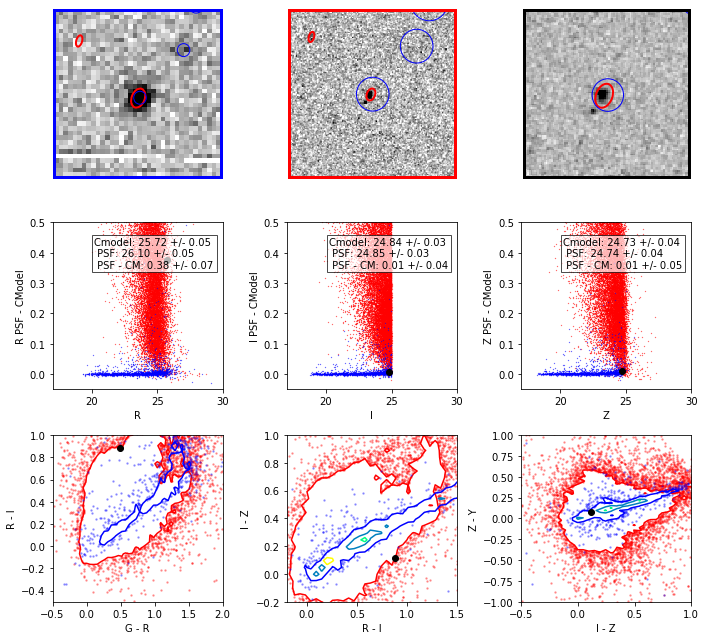

150.446139075 2.55686913833
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_087_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_087_sci.fits



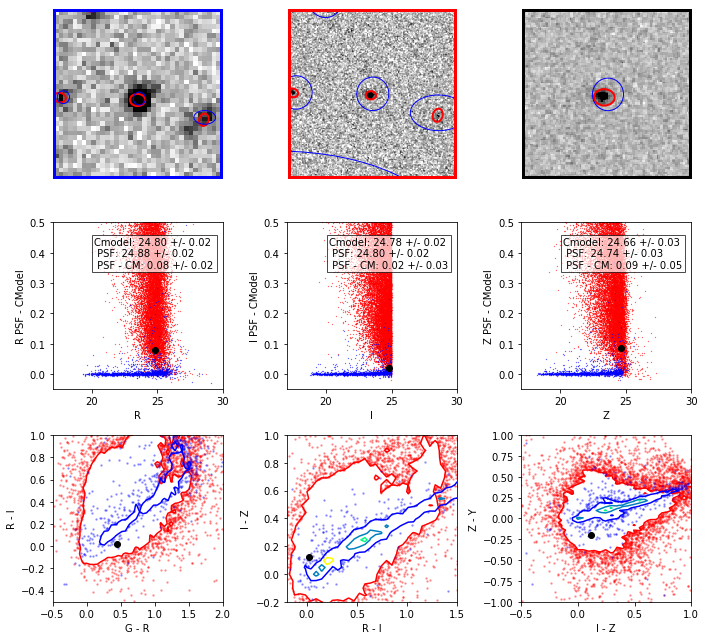

149.865529218 2.14034619908
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_067_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_067_sci.fits



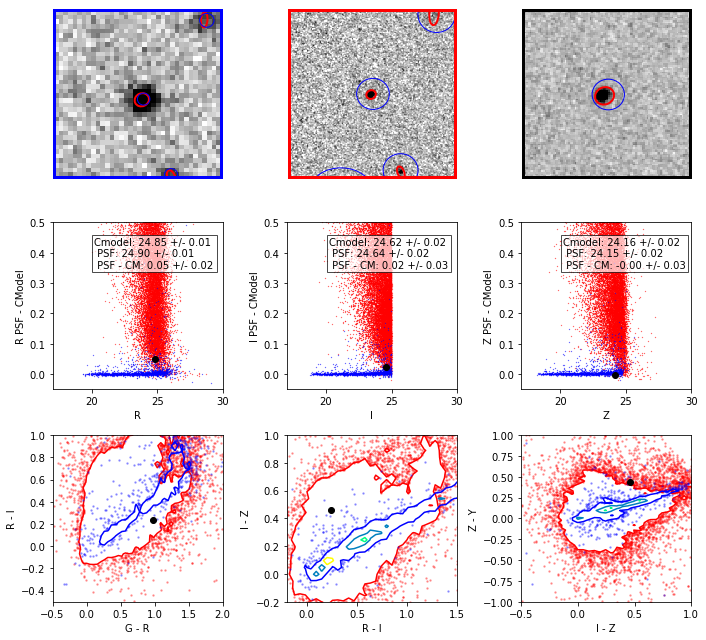

150.604114027 2.46927191161
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_086_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_086_sci.fits



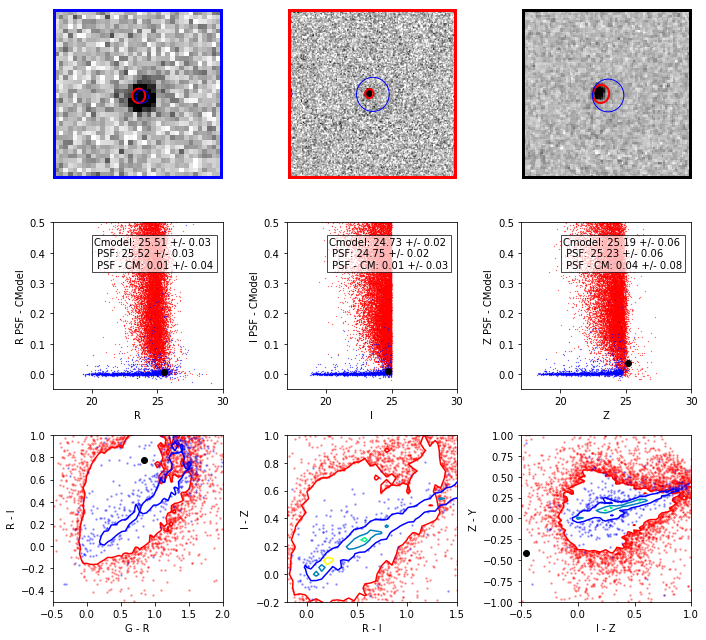

149.523873832 2.79022722159
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_105_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_105_sci.fits



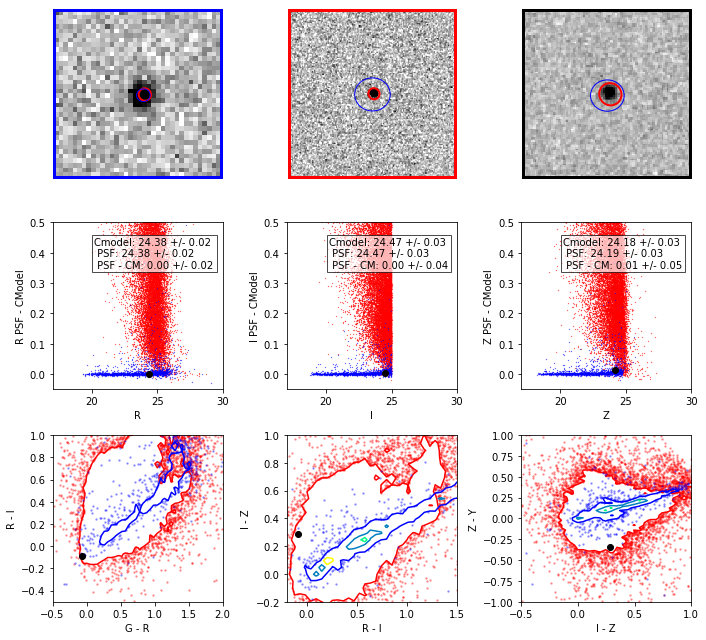

149.831340942 2.30215442191
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_079_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_079_sci.fits



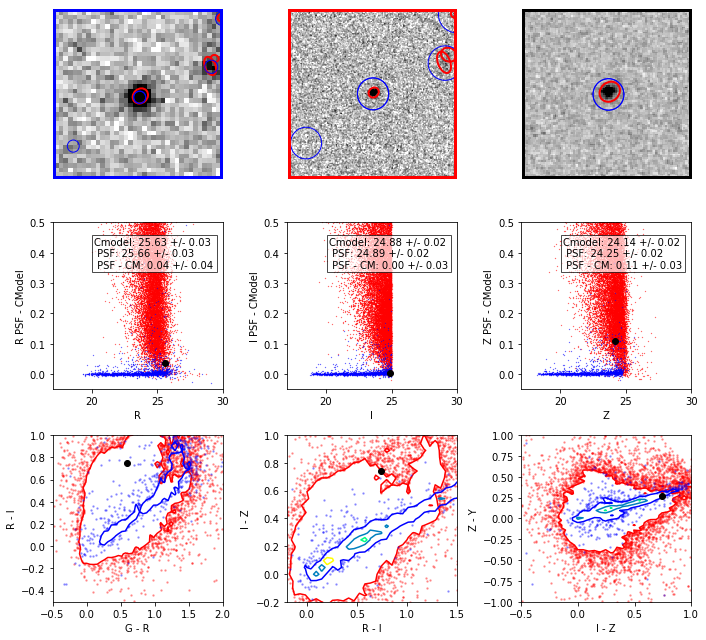

150.24522194 2.33982767831
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_076_sci.fits



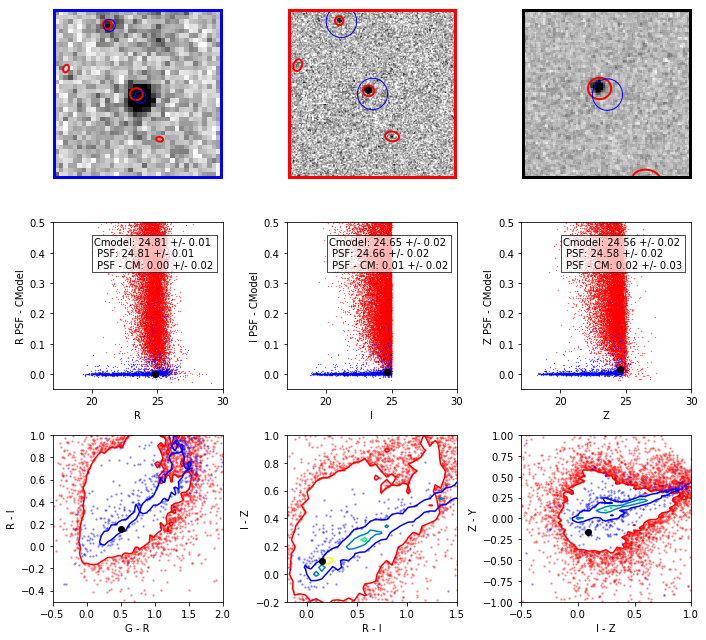

149.772143474 1.67525159246
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_031_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_031_sci.fits



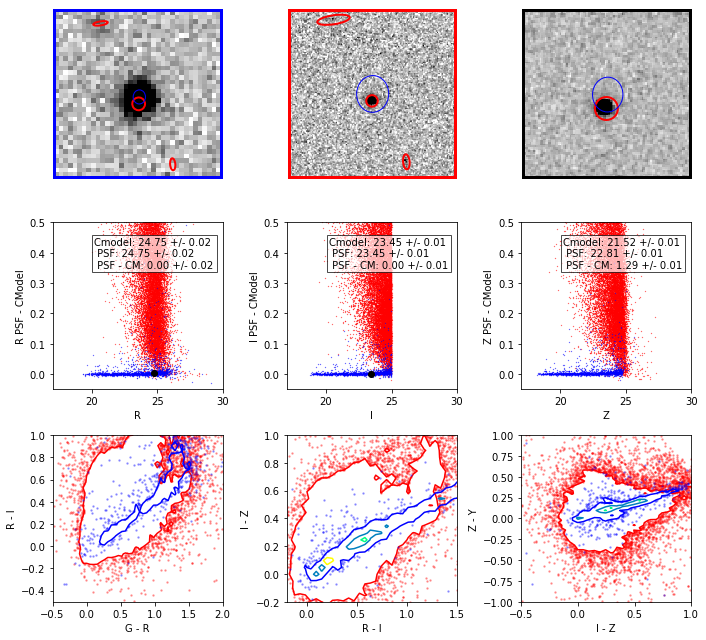

150.128952933 2.47497931967
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_089_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_089_sci.fits



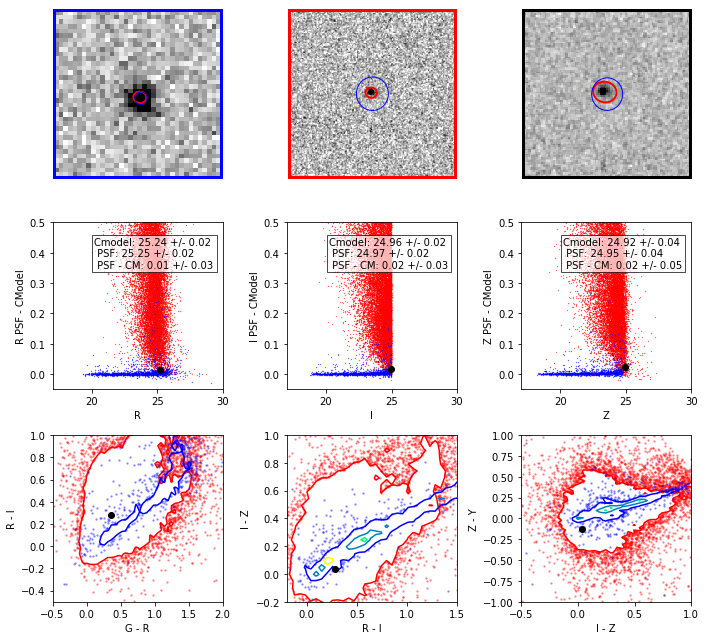

150.622209032 1.75779155974
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_026_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_026_sci.fits



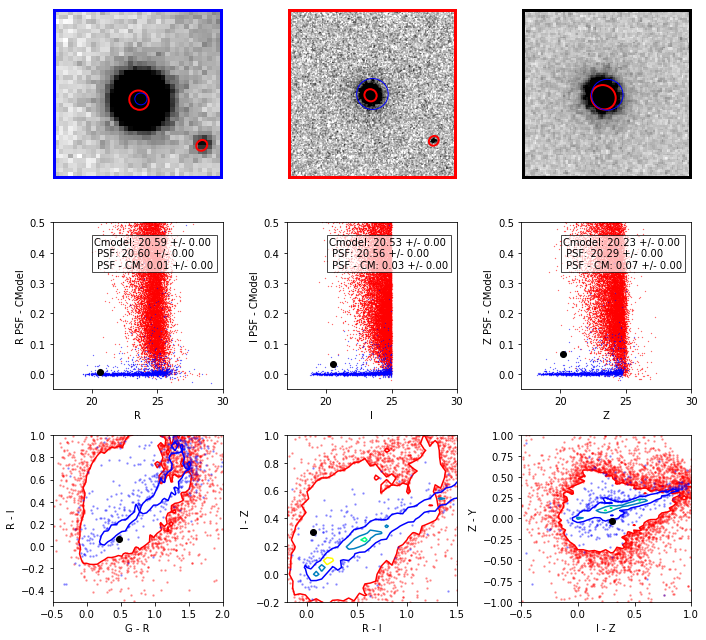

149.584612689 2.45364608973
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_080_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_080_sci.fits



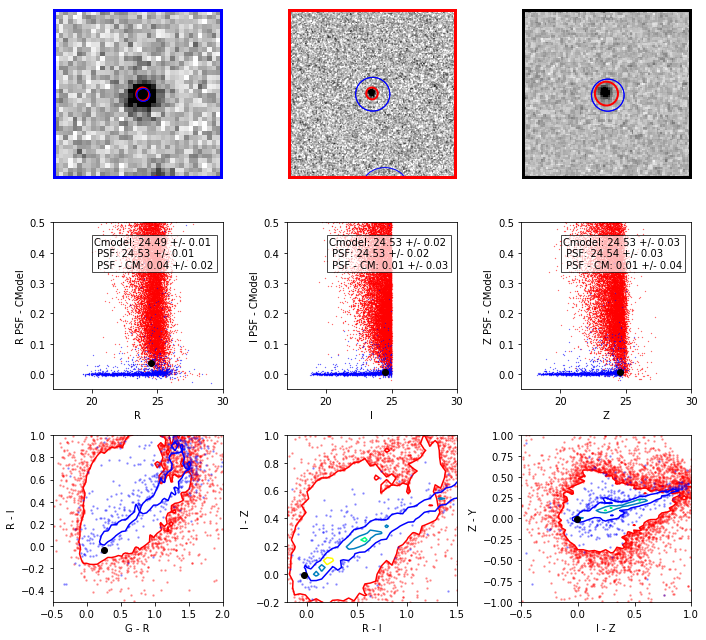

149.640117072 2.48363109768
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_092_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_092_sci.fits



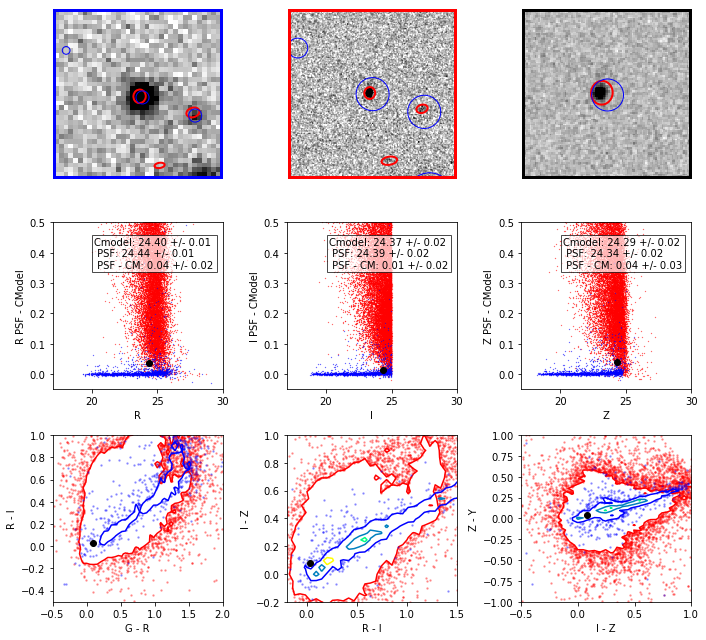

150.509095087 2.4566815895
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_075_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_075_sci.fits



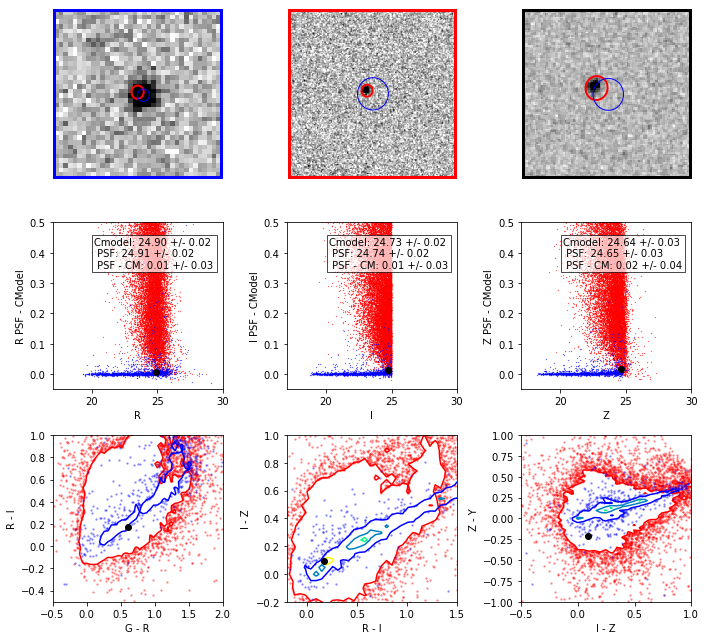

150.107937392 2.83855594008
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_113_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_113_sci.fits



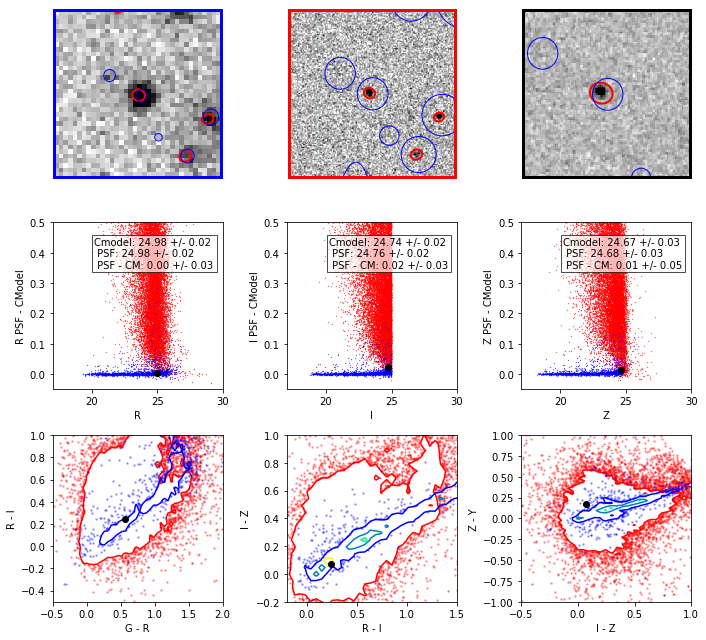

149.624203217 2.1806438258
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_068_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_068_sci.fits



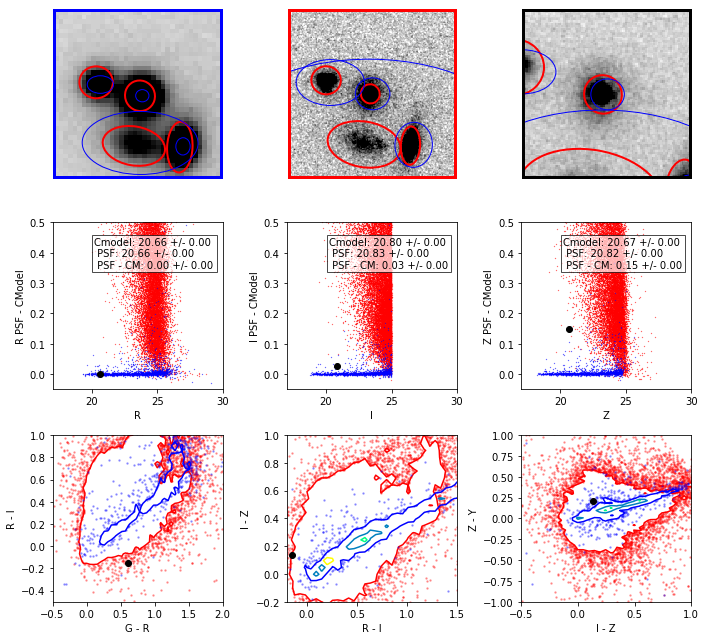

150.055009683 2.7410925667
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_102_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_102_sci.fits



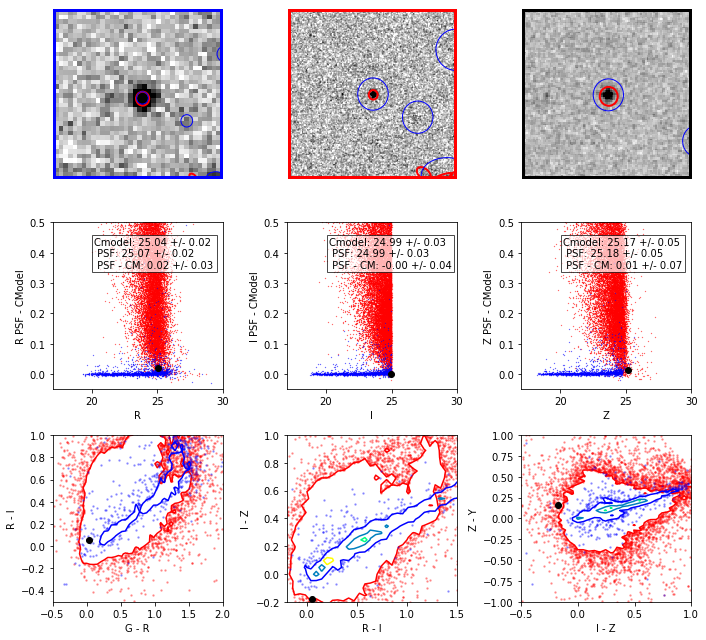

149.508032174 2.02866953154
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_057_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_057_sci.fits



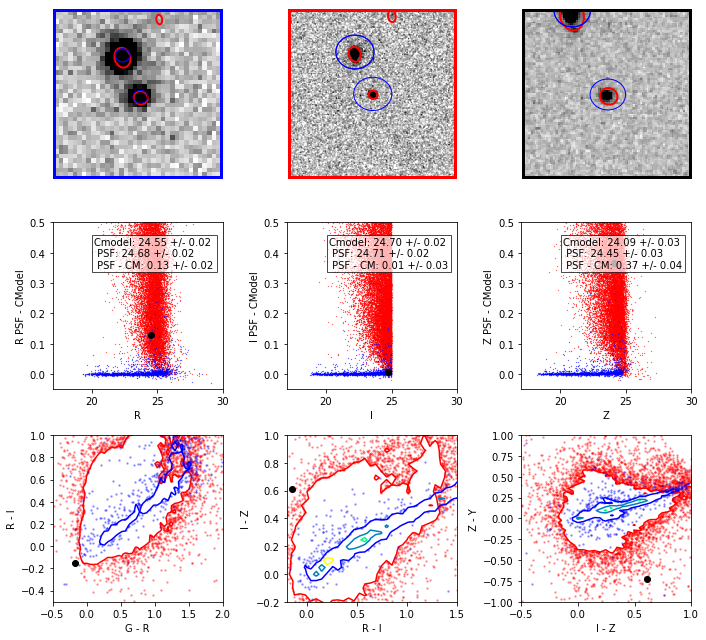

149.659147626 2.53727645717
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_092_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_092_sci.fits



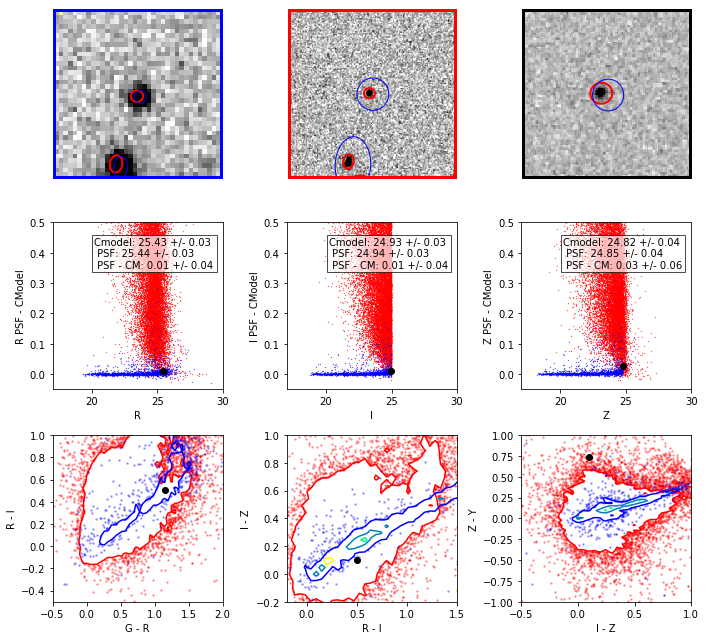

150.335568516 1.96048204685
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_040_sci.fits



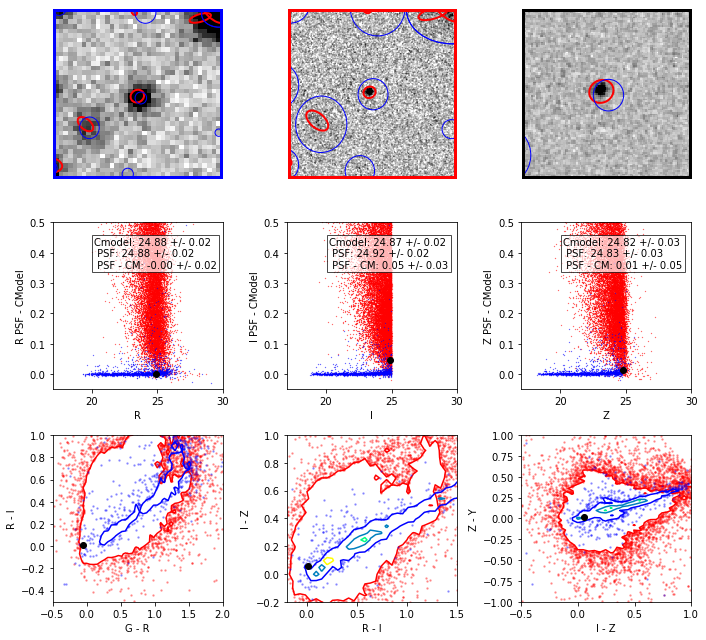

149.988598196 1.9283012833
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_042_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_042_sci.fits



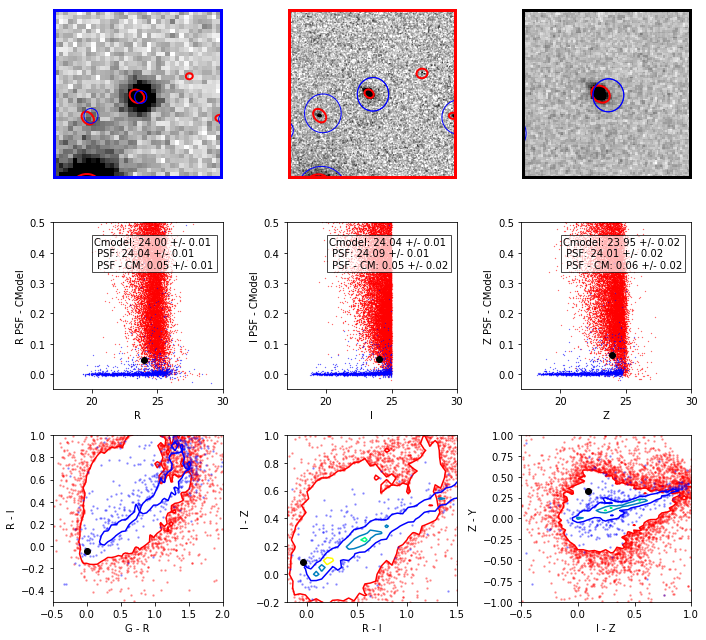

149.788650485 2.03122937835
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_055_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_055_sci.fits



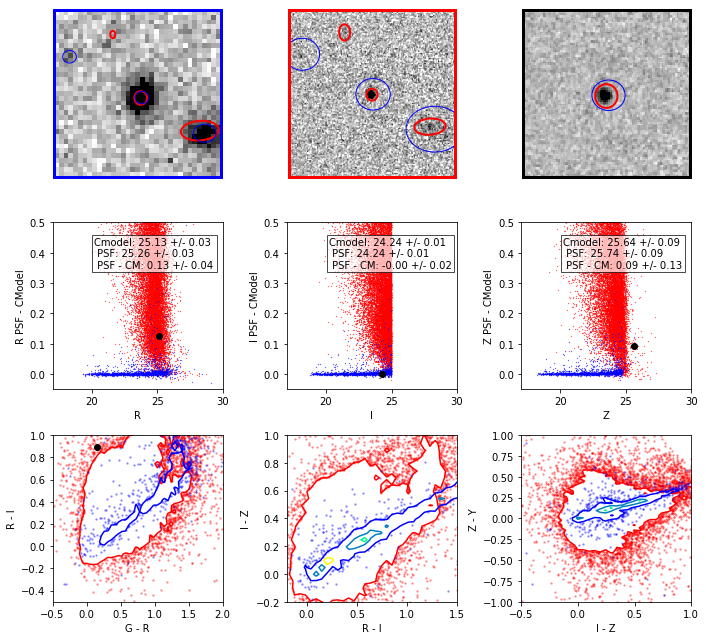

150.478491443 2.16385613855
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_063_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_063_sci.fits



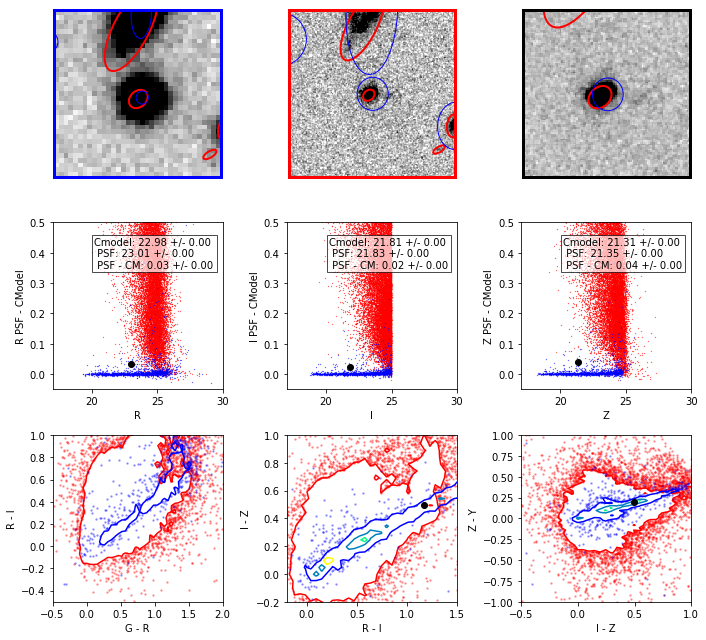

150.055842019 1.81326454076
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_042_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_042_sci.fits



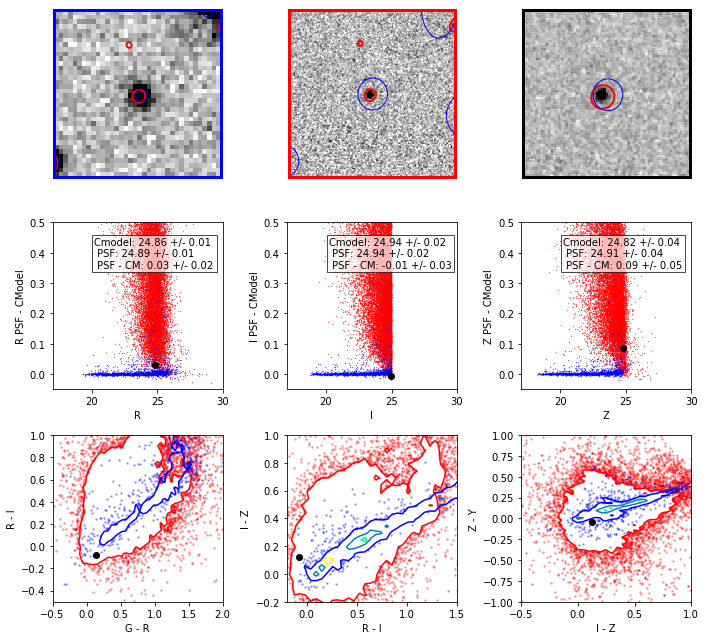

149.609107607 2.30724625579
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_080_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_080_sci.fits



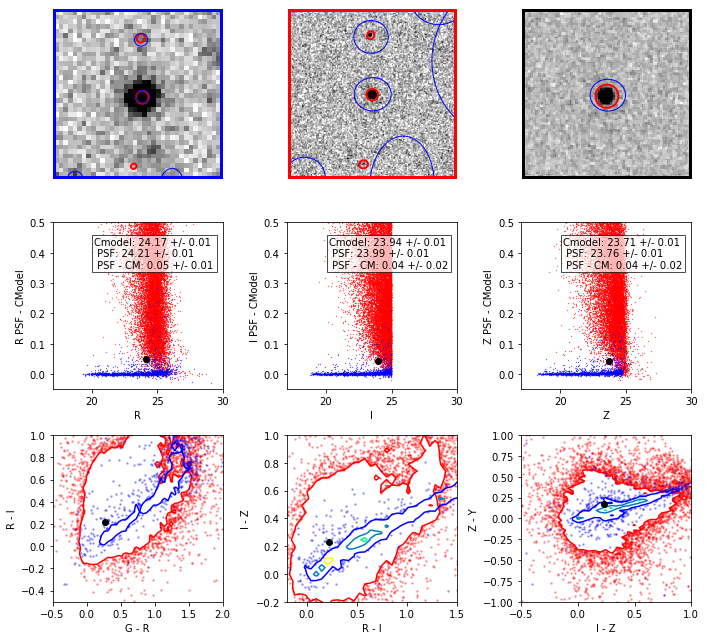

150.178455393 2.35355970302
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_077_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_077_sci.fits



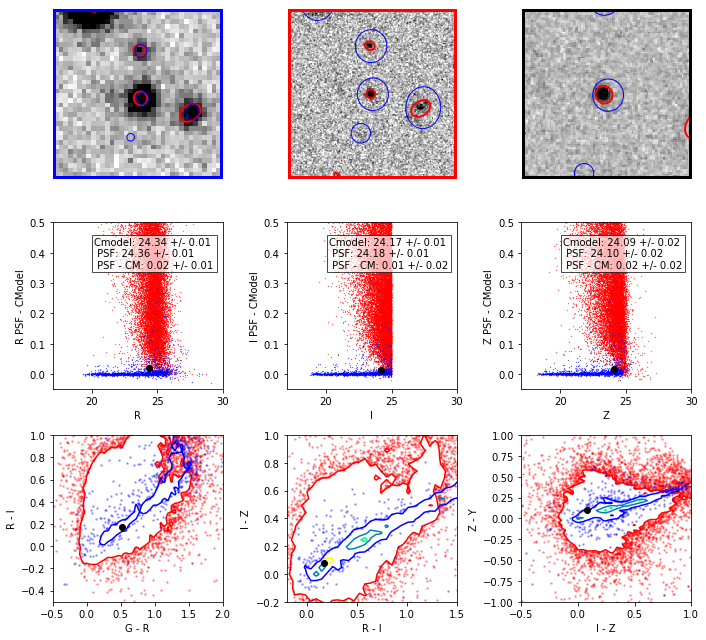

150.299465571 1.63717974529
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_028_sci.fits



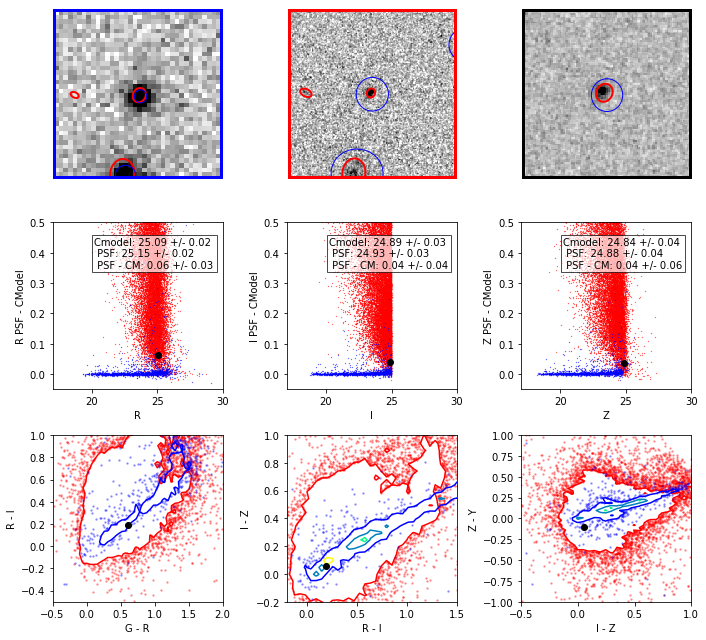

150.445494016 1.61608497608
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_015_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_015_sci.fits



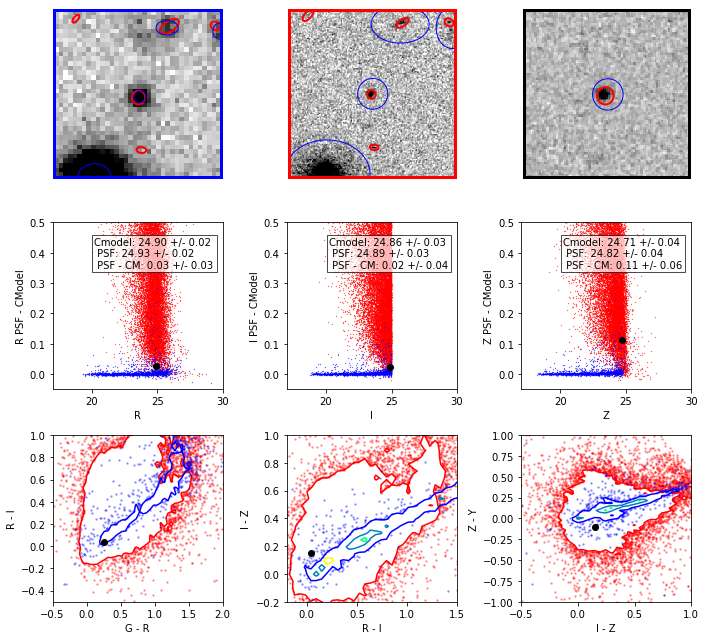

149.881402929 2.13599131045
/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_067_sci.fits

/scratch/sr525/hstCosmosImages/tiles/acs_I_030mas_067_sci.fits



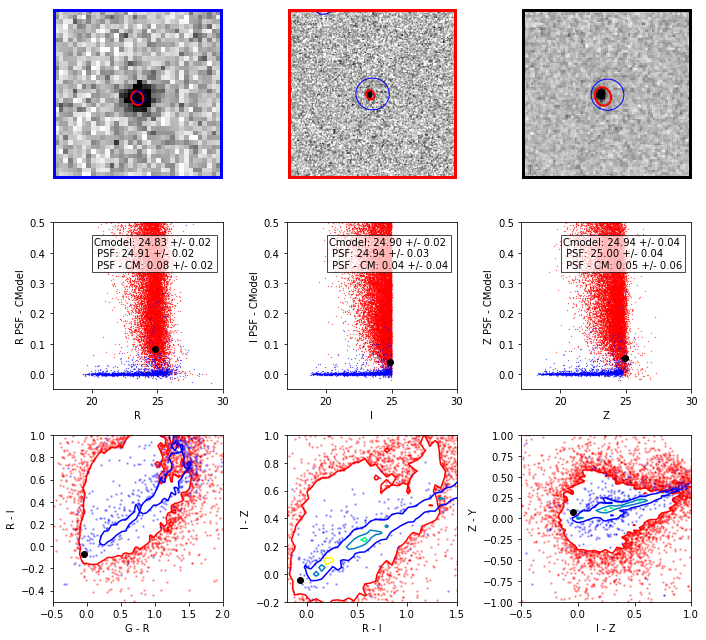

In [14]:
from starGalaxyPlots import hst_hsc_im_comp_plots

sg = "base_ClassificationExtendedness_value_I"


#print(t_hsc.columns)
#sg_sep = t_hsc_match[magPsfCol+"G"][star] - t_hsc_match[magModCol+"G"][star]
sg_ids = np.where((probs[:,0] < sep_prob) & (t_test["CLASS"] == 0) & \
                  (t_test["I_PM"] < 0.05))[0]

print(len(sg_ids))

ras = t_test["RA"][sg_ids]
decs = t_test["DEC"][sg_ids]
patches = t_test["PATCH"][sg_ids]

#for col in t_hsc.columns:
#    if "flag" in col:
#        print(col)
hst_hsc_im_comp_plots(t_test, sg_ids, t_hst, 6.0)

In [15]:
print(len(clf.estimators_))
print(clf.estimators_[0].decision_path(features.T))


400
  (0, 0)	1
  (0, 4)	1
  (0, 6)	1
  (1, 0)	1
  (1, 4)	1
  (1, 6)	1
  (2, 0)	1
  (2, 4)	1
  (2, 6)	1
  (3, 0)	1
  (3, 4)	1
  (3, 6)	1
  (4, 0)	1
  (4, 4)	1
  (4, 6)	1
  (5, 0)	1
  (5, 4)	1
  (5, 6)	1
  (6, 0)	1
  (6, 4)	1
  (6, 6)	1
  (7, 0)	1
  (7, 4)	1
  (7, 6)	1
  (8, 0)	1
  :	:
  (24048, 2)	1
  (24049, 0)	1
  (24049, 1)	1
  (24049, 2)	1
  (24050, 0)	1
  (24050, 1)	1
  (24050, 2)	1
  (24051, 0)	1
  (24051, 1)	1
  (24051, 2)	1
  (24052, 0)	1
  (24052, 4)	1
  (24052, 6)	1
  (24053, 0)	1
  (24053, 1)	1
  (24053, 2)	1
  (24054, 0)	1
  (24054, 1)	1
  (24054, 2)	1
  (24055, 0)	1
  (24055, 4)	1
  (24055, 6)	1
  (24056, 0)	1
  (24056, 4)	1
  (24056, 6)	1
